# Load Libraries

In [63]:
# import numpy as np
# from sys import getsizeof
# import copy
# import pandas as pd
# from joblib import Parallel, delayed

import imp
# from pandas.api.types import CategoricalDtype
# import matplotlib.pyplot as plt

import seaborn as sns
import sys

sys.path.insert(0, '../Scripts/')

import simpledrift as sd
imp.reload(sd)
import matrixmaker as mm

# import simpledrift as sd
# import matrixmaker as mm
import pandas as pd
import numpy as np
import importlib as imp
import matplotlib.pyplot as plt
import os
import math
import datatoEnv as dtv

import xarray as xr

import plotly.express as px
imp.reload(dtv)

import glob

sns.set_theme('paper', 'white', font_scale=1)



# test loading one dataset

In [2]:
testpath="/Users/ryanmaloney/Documents/GitHub/Simplified-Drift-Modeling/Results/realworlddata/figs_6-6-22/figs/PARVariance_COMO_c0.nc"
a=xr.load_dataset(testpath)
a.expand_dims(["chunk", "envvar", "variable", "siteID"])

<xarray.Dataset>
Dimensions:      (day: 1000, chunk: 1, envvar: 1, variable: 1, siteID: 1,
                  bet-hedging: 11, drift: 11, matureage: 3, envmeanvar: 3)
Coordinates:
  * day          (day) int32 0 1 2 3 4 5 6 7 ... 992 993 994 995 996 997 998 999
  * bet-hedging  (bet-hedging) float64 0.0 0.05 0.1 0.15 ... 0.35 0.4 0.45 0.5
  * drift        (drift) float64 0.0 0.01 0.02 0.03 0.04 ... 0.07 0.08 0.09 0.1
  * variable     (variable) object 'PARVariance'
  * siteID       (siteID) object 'COMO'
  * matureage    (matureage) int32 10 60 360
  * envmeanvar   (envmeanvar) float64 0.1 0.2 0.3
    birthrate    int32 40
  * envvar       (envvar) float64 0.3
  * chunk        (chunk) int32 0
Data variables:
    envi         (chunk, envvar, variable, siteID, day) float64 0.7833 ... -0...
    df           (chunk, envvar, variable, siteID, matureage, envmeanvar, bet-hedging, drift) float64 ...

In [3]:
ss=a["df"].squeeze().sel({"matureage":360}).sel({"envmeanvar":.3})
max1=ss.max()
ss==max1
ss.where(ss==max1, drop=True)['drift']
# px.imshow(np.log10(ss))

<xarray.DataArray 'drift' (drift: 1)>
array([0.03])
Coordinates:
  * drift       (drift) float64 0.03
    variable    object 'PARVariance'
    siteID      object 'COMO'
    matureage   int32 360
    envmeanvar  float64 0.3
    birthrate   int32 40
    envvar      float64 0.3
    chunk       int32 0

In [4]:
a

<xarray.Dataset>
Dimensions:      (day: 1000, bet-hedging: 11, drift: 11, matureage: 3,
                  envmeanvar: 3)
Coordinates:
  * day          (day) int32 0 1 2 3 4 5 6 7 ... 992 993 994 995 996 997 998 999
  * bet-hedging  (bet-hedging) float64 0.0 0.05 0.1 0.15 ... 0.35 0.4 0.45 0.5
  * drift        (drift) float64 0.0 0.01 0.02 0.03 0.04 ... 0.07 0.08 0.09 0.1
    variable     object 'PARVariance'
    siteID       object 'COMO'
  * matureage    (matureage) int32 10 60 360
  * envmeanvar   (envmeanvar) float64 0.1 0.2 0.3
    birthrate    int32 40
    envvar       float64 0.3
    chunk        int32 0
Data variables:
    envi         (day) float64 0.7833 -0.02879 1.509 ... -0.6662 -0.6634 -0.6645
    df           (matureage, envmeanvar, bet-hedging, drift) float64 2.751e+9...

In [5]:
xa=ss.where(ss==max1, drop=True)['drift']

In [6]:
np.expand_dims(np.array(xa),axis=1)

array([[0.03]])

In [7]:
# max_drift_i

In [8]:
imp.reload(dtv)
b=dtv.calculatedriftbhmax(a)
b

<xarray.Dataset>
Dimensions:      (day: 1000, bet-hedging: 11, drift: 11, matureage: 3,
                  envmeanvar: 3)
Coordinates:
  * day          (day) int32 0 1 2 3 4 5 6 7 ... 992 993 994 995 996 997 998 999
  * bet-hedging  (bet-hedging) float64 0.0 0.05 0.1 0.15 ... 0.35 0.4 0.45 0.5
  * drift        (drift) float64 0.0 0.01 0.02 0.03 0.04 ... 0.07 0.08 0.09 0.1
    variable     object 'PARVariance'
    siteID       object 'COMO'
  * matureage    (matureage) int32 10 60 360
  * envmeanvar   (envmeanvar) float64 0.1 0.2 0.3
    birthrate    int32 40
    envvar       float64 0.3
    chunk        int32 0
Data variables:
    envi         (day) float64 0.7833 -0.02879 1.509 ... -0.6662 -0.6634 -0.6645
    df           (matureage, envmeanvar, bet-hedging, drift) float64 2.751e+9...

In [9]:
## calculate max drift and bet-hedging for each envmeanvar and matureage
b=a
flag=False
for emv in a["envmeanvar"]:
    for ma in a["matureage"]:
        singlerun=a.sel({"envmeanvar":emv}).sel({"matureage":ma})
        da=singlerun["df"].squeeze()
        # print(da)
        max1=da.max()

        emvi=np.expand_dims(emv.data, axis=0)
        mai=np.expand_dims(int(ma.data), axis=0)

        maxdrifti=np.expand_dims(np.array(singlerun.where(singlerun==max1, drop=True)['drift']), axis=1)
        maxbhi=np.expand_dims(np.array(singlerun.where(singlerun==max1, drop=True)['bet-hedging']), axis=1)
        # print(maxdrifti.shape)
        max_drift_i=xr.DataArray(data=maxdrifti,
         coords={"envmeanvar":emvi, "matureage":mai},
         name="maxdrifti")
        max_bh_i=xr.DataArray(data=maxbhi,
         coords={"envmeanvar":emvi, "matureage":mai},
         name="maxbhi")
        comb=xr.merge([max_drift_i, max_bh_i])
        if flag:
            # print(z)
            # print(max_drift_i)
            z=xr.merge([z, comb], join="outer")
        else:
            flag=True
            z=comb
        # b["max_drift_i"]=max_drift_i
        # b[{"maxpop_drift_index":max_drift_i}]

b.merge(z)
# max_drift_i
# z

<xarray.Dataset>
Dimensions:      (day: 1000, bet-hedging: 11, drift: 11, matureage: 3,
                  envmeanvar: 3)
Coordinates:
  * day          (day) int32 0 1 2 3 4 5 6 7 ... 992 993 994 995 996 997 998 999
  * bet-hedging  (bet-hedging) float64 0.0 0.05 0.1 0.15 ... 0.35 0.4 0.45 0.5
  * drift        (drift) float64 0.0 0.01 0.02 0.03 0.04 ... 0.07 0.08 0.09 0.1
    variable     object 'PARVariance'
    siteID       object 'COMO'
  * matureage    (matureage) int32 10 60 360
  * envmeanvar   (envmeanvar) float64 0.1 0.2 0.3
    birthrate    int32 40
    envvar       float64 0.3
    chunk        int32 0
Data variables:
    envi         (day) float64 0.7833 -0.02879 1.509 ... -0.6662 -0.6634 -0.6645
    df           (matureage, envmeanvar, bet-hedging, drift) float64 2.751e+9...
    maxdrifti    (envmeanvar, matureage) float64 0.0 0.0 0.01 ... 0.0 0.0 0.03
    maxbhi       (envmeanvar, matureage) float64 0.0 0.05 0.1 ... 0.2 0.25 0.5

# run all sims

In [10]:
testpath="/Users/ryanmaloney/Documents/GitHub/Simplified-Drift-Modeling/Results/realworlddata/figs_6-6-22/figs/"
allsims=glob.glob(testpath+"*.nc")
print(len(allsims))

allsims[0:3]


47413


['/Users/ryanmaloney/Documents/GitHub/Simplified-Drift-Modeling/Results/realworlddata/figs_6-6-22/figs/avgoverall_station FIE00144212_c4.nc',
 '/Users/ryanmaloney/Documents/GitHub/Simplified-Drift-Modeling/Results/realworlddata/figs_6-6-22/figs/prcpoverall_station USW00053819_c4.nc',
 '/Users/ryanmaloney/Documents/GitHub/Simplified-Drift-Modeling/Results/realworlddata/figs_6-6-22/figs/avgoverall_station USS0021C13S_c0.nc']

In [11]:
# imp.reload(dtv)
# dtv.calcmaxes(list[0])

## Load the results of all simresults.nc

In [12]:
# imp.reload(dtv)
# c=dtv.combinealldata(allsims)
# c
#this is already processed for max
c=xr.load_dataset('allsimresults.nc')
c


<xarray.Dataset>
Dimensions:      (simkey: 46526, day: 1000, bet-hedging: 11, drift: 11,
                  envmeanvar: 3, matureage: 3)
Coordinates:
    variable     (simkey) object 'PARMaximum' 'PARMaximum' ... 'wsf5overall'
    siteID       (simkey) object 'ARIK' 'COMO' ... 'station USW00094985'
    chunk        (simkey) int32 0 0 0 0 0 0 0 0 0 0 0 ... 6 6 6 6 6 6 6 6 6 6 6
  * day          (day) int32 0 1 2 3 4 5 6 7 ... 992 993 994 995 996 997 998 999
  * bet-hedging  (bet-hedging) float64 0.0 0.05 0.1 0.15 ... 0.35 0.4 0.45 0.5
  * drift        (drift) float64 0.0 0.01 0.02 0.03 0.04 ... 0.07 0.08 0.09 0.1
  * matureage    (matureage) int32 10 60 360
  * envmeanvar   (envmeanvar) float64 0.1 0.2 0.3
    birthrate    int32 40
    envvar       float64 0.3
Dimensions without coordinates: simkey
Data variables:
    envi         (day, simkey) float64 -1.673 1.925 1.012 ... 2.166 2.81 -0.6664
    maxdrifti    (envmeanvar, matureage, simkey) float64 0.0 0.0 ... 0.02 0.01
    maxbhi       (envmeanvar, matureage, simkey) float64 0.05 0.0 ... 0.05 0.0
    df           (matureage, envmeanvar, bet-hedging, drift, simkey) float64 ...

In [13]:
#filter c for matureage=10 and envmeanvar=.2 
cf=c.sel({"matureage":10}).sel({"envmeanvar":.3})
cf

<xarray.Dataset>
Dimensions:      (simkey: 46526, day: 1000, bet-hedging: 11, drift: 11)
Coordinates:
    variable     (simkey) object 'PARMaximum' 'PARMaximum' ... 'wsf5overall'
    siteID       (simkey) object 'ARIK' 'COMO' ... 'station USW00094985'
    chunk        (simkey) int32 0 0 0 0 0 0 0 0 0 0 0 ... 6 6 6 6 6 6 6 6 6 6 6
  * day          (day) int32 0 1 2 3 4 5 6 7 ... 992 993 994 995 996 997 998 999
  * bet-hedging  (bet-hedging) float64 0.0 0.05 0.1 0.15 ... 0.35 0.4 0.45 0.5
  * drift        (drift) float64 0.0 0.01 0.02 0.03 0.04 ... 0.07 0.08 0.09 0.1
    matureage    int32 10
    envmeanvar   float64 0.3
    birthrate    int32 40
    envvar       float64 0.3
Dimensions without coordinates: simkey
Data variables:
    envi         (day, simkey) float64 -1.673 1.925 1.012 ... 2.166 2.81 -0.6664
    maxdrifti    (simkey) float64 0.0 0.0 0.0 0.0 0.0 ... 0.0 0.0 0.0 0.0 0.0
    maxbhi       (simkey) float64 0.25 0.25 0.25 0.2 0.2 ... 0.1 0.1 0.1 0.05
    df           (bet-hedging, drift, simkey) float64 2.437e-82 ... 3.074e-90

# PCA

In [14]:
from sklearn.decomposition import PCA
pca=PCA()

In [15]:
c

<xarray.Dataset>
Dimensions:      (simkey: 46526, day: 1000, bet-hedging: 11, drift: 11,
                  envmeanvar: 3, matureage: 3)
Coordinates:
    variable     (simkey) object 'PARMaximum' 'PARMaximum' ... 'wsf5overall'
    siteID       (simkey) object 'ARIK' 'COMO' ... 'station USW00094985'
    chunk        (simkey) int32 0 0 0 0 0 0 0 0 0 0 0 ... 6 6 6 6 6 6 6 6 6 6 6
  * day          (day) int32 0 1 2 3 4 5 6 7 ... 992 993 994 995 996 997 998 999
  * bet-hedging  (bet-hedging) float64 0.0 0.05 0.1 0.15 ... 0.35 0.4 0.45 0.5
  * drift        (drift) float64 0.0 0.01 0.02 0.03 0.04 ... 0.07 0.08 0.09 0.1
  * matureage    (matureage) int32 10 60 360
  * envmeanvar   (envmeanvar) float64 0.1 0.2 0.3
    birthrate    int32 40
    envvar       float64 0.3
Dimensions without coordinates: simkey
Data variables:
    envi         (day, simkey) float64 -1.673 1.925 1.012 ... 2.166 2.81 -0.6664
    maxdrifti    (envmeanvar, matureage, simkey) float64 0.0 0.0 ... 0.02 0.01
    maxbhi       (envmeanvar, matureage, simkey) float64 0.05 0.0 ... 0.05 0.0
    df           (matureage, envmeanvar, bet-hedging, drift, simkey) float64 ...

In [16]:
# c=cf
stacked=cf["df"].stack(strat=["bet-hedging", "drift"])
dfs=stacked.stack(runkey=["simkey"])
dfs=np.log10(dfs)

In [17]:
# x_pca = pca.transform(X_centered)
dfs_mean=dfs.groupby('runkey').mean(...)
dfs_std=dfs.groupby('runkey').std(...)

In [18]:
dfs_centered=dfs-dfs_mean

In [19]:
# dfs_centered=dfs_centered/dfs_std

In [20]:
# dfs_centered[]

In [21]:
dfs_centered["runkey"].to_dataframe()['siteID'].unique()

array(['ARIK', 'COMO', 'GUIL', ..., 'TOOL', 'KONA', 'SUGG'], dtype=object)

In [22]:
pca.fit(dfs_centered.T)
x_pca=pca.transform(dfs_centered.T)

In [23]:
dfs.mean(dim=...)

<xarray.DataArray 'df' ()>
array(-17.51690697)
Coordinates:
    matureage   int32 10
    envmeanvar  float64 0.3
    birthrate   int32 40
    envvar      float64 0.3

In [24]:
# c["maxdrifti"].stack(runkey=["matureage", "envmeanvar", "simkey"]) # if not already filtered otherwise drop matureageenvmeanvar
# cf["maxdrifti"].stack(runkey=["simkey"]) # if not already filtered otherwise drop matureageenvmeanvar

In [25]:
# pca.explained_variance_ratio_
x=px.scatter(x=x_pca[:,0], y=x_pca[:,1], color=dfs["variable"])
x.layout.xaxis.title.text=('PC 1 ({:.1f}%)'.format(100*pca.explained_variance_ratio_[0]))
x.layout.yaxis.title.text=('PC 2 ({:.1f}%)'.format(100*pca.explained_variance_ratio_[1]))
x.layout.title.text="PCs of final population plots"
x

In [26]:
c

<xarray.Dataset>
Dimensions:      (simkey: 46526, day: 1000, bet-hedging: 11, drift: 11,
                  envmeanvar: 3, matureage: 3)
Coordinates:
    variable     (simkey) object 'PARMaximum' 'PARMaximum' ... 'wsf5overall'
    siteID       (simkey) object 'ARIK' 'COMO' ... 'station USW00094985'
    chunk        (simkey) int32 0 0 0 0 0 0 0 0 0 0 0 ... 6 6 6 6 6 6 6 6 6 6 6
  * day          (day) int32 0 1 2 3 4 5 6 7 ... 992 993 994 995 996 997 998 999
  * bet-hedging  (bet-hedging) float64 0.0 0.05 0.1 0.15 ... 0.35 0.4 0.45 0.5
  * drift        (drift) float64 0.0 0.01 0.02 0.03 0.04 ... 0.07 0.08 0.09 0.1
  * matureage    (matureage) int32 10 60 360
  * envmeanvar   (envmeanvar) float64 0.1 0.2 0.3
    birthrate    int32 40
    envvar       float64 0.3
Dimensions without coordinates: simkey
Data variables:
    envi         (day, simkey) float64 -1.673 1.925 1.012 ... 2.166 2.81 -0.6664
    maxdrifti    (envmeanvar, matureage, simkey) float64 0.0 0.0 ... 0.02 0.01
    maxbhi       (envmeanvar, matureage, simkey) float64 0.05 0.0 ... 0.05 0.0
    df           (matureage, envmeanvar, bet-hedging, drift, simkey) float64 ...

In [27]:
y=px.scatter(x=x_pca[:,0], y=x_pca[:,1], color=cf["maxdrifti"].stack(runkey=["simkey"]))
y.layout.xaxis.title.text=('PC 1 ({:.1f}%)'.format(100*pca.explained_variance_ratio_[0]))
y.layout.yaxis.title.text=('PC 2 ({:.1f}%)'.format(100*pca.explained_variance_ratio_[1]))
y.layout.coloraxis.colorbar.title.text='MaxDrift'
y.layout.title.text="Peak Drift for PCs"
y

In [28]:
dfs["variable"]

<xarray.DataArray 'variable' (runkey: 46526)>
array(['PARMaximum', 'PARMaximum', 'PARMaximum', ..., 'wsf5overall',
       'wsf5overall', 'wsf5overall'], dtype=object)
Coordinates:
    variable    (runkey) object 'PARMaximum' 'PARMaximum' ... 'wsf5overall'
    siteID      (runkey) object 'ARIK' 'COMO' ... 'station USW00094985'
    chunk       (runkey) int32 0 0 0 0 0 0 0 0 0 0 0 0 ... 6 6 6 6 6 6 6 6 6 6 6
    matureage   int32 10
    envmeanvar  float64 0.3
    birthrate   int32 40
    envvar      float64 0.3
  * runkey      (runkey) object MultiIndex
  * simkey      (runkey) int64 0 1 2 3 4 5 ... 46521 46522 46523 46524 46525

In [29]:
z=px.scatter(x=x_pca[:,0], y=x_pca[:,1], color=cf["maxbhi"].stack(runkey=["simkey"]))
z.layout.xaxis.title.text=('PC 1 ({:.1f}%)'.format(100*pca.explained_variance_ratio_[0]))
z.layout.yaxis.title.text=('PC 2 ({:.1f}%)'.format(100*pca.explained_variance_ratio_[1]))
z.layout.coloraxis.colorbar.title.text='Max BH'
z.layout.title.text="Peak BH"
z

## Classifying sites by Koppen Climate Classification

In [71]:
sitekccforpca = pd.read_csv('siteclass.csv', index_col = 0)
sitekccforpca

,0
0,BSk
1,Dfc
2,Af
3,Dfb
4,Cfa
...,...
46521,Dfb
46522,Dfa
46523,Dfb
46524,Dfa


In [ ]:

sitesmaybe = sitekccforpca.iloc[:,0].to_list()
sitesmaybe
mylist = list(range(0, 46526))
sortedsites = sitekccforpca.iloc[mylist]
# mylist = list(range(0, 46526))
sortedsites

In [31]:
sortedsites = sitekccforpca.iloc[mylist]
sortedsites = sortedsites.iloc[:,0].to_list()
sortedsitesbybroadcategory = []
for x in range(len(sortedsites)):
    if sortedsites[x].startswith('      A'):
        sortedsitesbybroadcategory.append('A')
    if sortedsites[x].startswith('     BS'):
        sortedsitesbybroadcategory.append('BS')
    if sortedsites[x].startswith('     BW'):
        sortedsitesbybroadcategory.append('BW')
    if sortedsites[x].startswith('     Cf'):
        sortedsitesbybroadcategory.append('Cf')
    if sortedsites[x].startswith('     Cs'):
        sortedsitesbybroadcategory.append('Cs')
    if sortedsites[x].startswith('     Cw'):
        sortedsitesbybroadcategory.append('Cw')
    if sortedsites[x].startswith('     Df'):
        sortedsitesbybroadcategory.append('Df')
    if sortedsites[x].startswith('     Ds'):
        sortedsitesbybroadcategory.append('Ds')
    if sortedsites[x].startswith('     Dw'):
        sortedsitesbybroadcategory.append('Dw')
    if sortedsites[x].startswith('      E'):
        sortedsitesbybroadcategory.append('E')

In [32]:
sortedsitesbybroadestcategory = []
for x in range(len(sortedsites)):
    if sortedsites[x].startswith('      A'):
        sortedsitesbybroadestcategory.append('A')
    if sortedsites[x].startswith('     B'):
        sortedsitesbybroadestcategory.append('B')
    if sortedsites[x].startswith('     C'):
        sortedsitesbybroadestcategory.append('C')
    if sortedsites[x].startswith('      D'):
        sortedsitesbybroadestcategory.append('D')
    if sortedsites[x].startswith('      E'):
        sortedsitesbybroadestcategory.append('E')

In [66]:
len(sortedsites)

46526

In [75]:
simkeykccindex=sitekccforpca.reset_index()
simkeykccindex.columns=["simkey", "KCC"]
simkeykccindex

,simkey,KCC
0,0,BSk
1,1,Dfc
2,2,Af
3,3,Dfb
4,4,Cfa
...,...,...
46521,46521,Dfb
46522,46522,Dfa
46523,46523,Dfb
46524,46524,Dfa


In [34]:
# plot_df["KCC_Category"] = sortedsitesbybroadestcategory

NameError: name 'plot_df' is not defined

In [35]:
len(sortedsitesbybroadcategory)


46526

## FIgure 4: PCA by Koppen

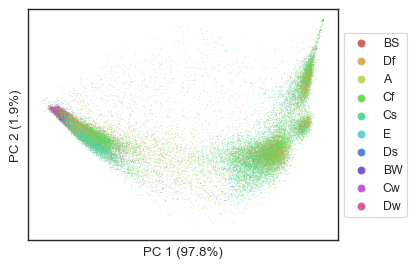

In [36]:
sns.set(rc={"figure.figsize":(4, 3)}) #width=8, height=4
sns.set_theme('paper', 'white', font_scale=1)
xlab='PC 1 ({:.1f}%)'.format(100*pca.explained_variance_ratio_[0])
ylab='PC 2 ({:.1f}%)'.format(100*pca.explained_variance_ratio_[1])
plot_df=pd.DataFrame({xlab:x_pca[:,0], ylab:x_pca[:,1], "coloring":dfs["siteID"]})
plot_df["KCC_Category"] = sortedsitesbybroadcategory
# coloring=cf["maxbhi"].stack(runkey=["simkey"])
fig, ax = plt.subplots()
palette = "hls"
g=sns.scatterplot(data=plot_df, x=xlab, y=ylab, hue="KCC_Category", palette=palette, marker='.', s=.5, edgecolor=None, alpha=1, #legend=None
                  )
g.legend(loc='center left', bbox_to_anchor=(1, .5), ncol=1)
g.set_xticks([])
g.set_yticks([])

# norm = plt.Normalize(coloring.min(), coloring.max())
# cmap = sns.cubehelix_palette(light=1, as_cmap=True)
# sm = plt.cm.ScalarMappable(cmap=palette, norm=norm)
# sm.set_array([])

# cax = fig.add_axes([ax.get_position().x1+0.05, ax.get_position().y0, 0.06, ax.get_position().height])
# ax.figure.colorbar(sm, cax=cax, label="Max Drift")  g
#label x axis
# ax.figure.axes[1].set_xlabel('PC 1 ({:.1f}%)'.format(100*pca.explained_variance_ratio_[0])) 
# ax.figure.axes[1].set_ylabel('PC 2 ({:.1f}%)'.format(100*pca.explained_variance_ratio_[1]))
# ax.figure.axes[1].set(position='left')
# fig.savefig("../Figures/F4G_PCAbyKCC.pdf")
plt.show()

In [37]:
variables_list=dfs["variable"].to_dataframe().iloc[:,0]
#count number of times each variable appears in variables_list
variables_list=variables_list.reset_index()
variables_list

,simkey,variable
0,0,PARMaximum
1,1,PARMaximum
2,2,PARMaximum
3,3,PARMaximum
4,4,PARMaximum
...,...,...
46521,46521,wsf5overall
46522,46522,wsf5overall
46523,46523,wsf5overall
46524,46524,wsf5overall


In [38]:
#add a column to variables_list that is the number of times each variable appears in variables_list
variables_list_count=variables_list["variable"].value_counts()  #this is a series
variables_list_count=variables_list_count.to_frame() #this is a dataframe
variables_list_count.columns=["count"]
variables_list_count.reset_index(inplace=True)
variables_list_count.columns=["variable", "count"]
variables_list_count

,variable,count
0,avgoverall,20906
1,prcpoverall,4383
2,wsf2overall,4345
3,wsf5overall,4323
4,awndoverall,4315
5,tmaxoverall,4299
6,pgtmoverall,2003
7,snwdoverall,1149
8,tsunoverall,89
9,inLWMaximum,67


In [39]:

# variables_list_count["variable"]=variables_list_count.index #make the index a column  
# variables_list_count=variables_list_count.reset_index(drop=True) #reset the index 
variables_w_count=pd.merge(variables_list, variables_list_count, how='right').sort_values(by="simkey") #merge the two dataframes on the variable column
index_lown=variables_w_count["count"]<100
variables_w_count.loc[index_lown, "variable"]="Other"
variables_w_count

,simkey,variable,count
46397,0,Other,13
46398,1,Other,13
46399,2,Other,13
46400,3,Other,13
46401,4,Other,13
...,...,...,...
33952,46521,wsf5overall,4323
33953,46522,wsf5overall,4323
33954,46523,wsf5overall,4323
33955,46524,wsf5overall,4323


In [40]:
variables_list

,simkey,variable
0,0,PARMaximum
1,1,PARMaximum
2,2,PARMaximum
3,3,PARMaximum
4,4,PARMaximum
...,...,...
46521,46521,wsf5overall
46522,46522,wsf5overall
46523,46523,wsf5overall
46524,46524,wsf5overall


## Figure 4: PCA by measure

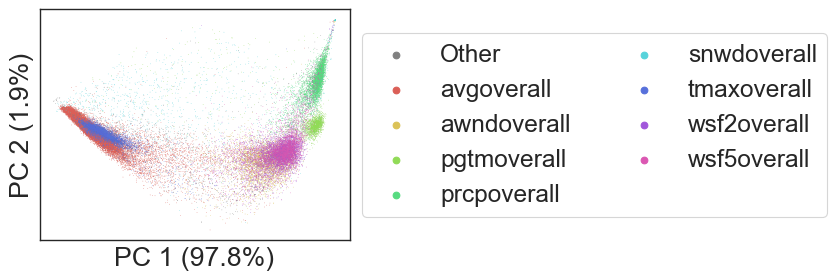

In [41]:
sns.set(rc={"figure.figsize":(4, 3)}) #width=8, height=4
sns.set_theme('paper', 'white', font_scale=2)

xlab='PC 1 ({:.1f}%)'.format(100*pca.explained_variance_ratio_[0])
ylab='PC 2 ({:.1f}%)'.format(100*pca.explained_variance_ratio_[1])
plot_df=pd.DataFrame({xlab:x_pca[:,0], ylab:x_pca[:,1], "coloring":variables_w_count["variable"]})
plot_df
# coloring=cf["maxbhi"].stack(runkey=["simkey"])

measures = (variables_w_count["variable"].unique())
greys = iter(sns.color_palette("hls", len(measures)-1))
palette = {measure: 'grey' if measure == "Other" else next(greys) for measure in measures}

fig, ax = plt.subplots()
# palette = "hls"
g=sns.scatterplot(data=plot_df, x=xlab, y=ylab, hue="coloring", palette=palette, marker='.', s=.5, edgecolor=None, alpha=1)
g.legend(loc='center left', bbox_to_anchor=(1, .5), ncol=2)
g.set_xticks([])
g.set_yticks([])
fig.savefig("../Figures/F4F_PCAbyMeasurement.pdf")
# norm = plt.Normalize(coloring.min(), coloring.max())
# cmap = sns.cubehelix_palette(light=1, as_cmap=True)
# sm = plt.cm.ScalarMappable(cmap=palette, norm=norm)
# sm.set_array([])

# cax = fig.add_axes([ax.get_position().x1+0.05, ax.get_position().y0, 0.06, ax.get_position().height])
# ax.figure.colorbar(sm, cax=cax, label="Max Drift")
#label x axis
# ax.figure.axes[1].set_xlabel('PC 1 ({:.1f}%)'.format(100*pca.explained_variance_ratio_[0])) 
# ax.figure.axes[1].set_ylabel('PC 2 ({:.1f}%)'.format(100*pca.explained_variance_ratio_[1]))
# ax.figure.axes[1].set(position='left')
plt.show()

In [42]:
palette

{'Other': 'grey',
 'avgoverall': (0.86, 0.3712, 0.33999999999999997),
 'awndoverall': (0.86, 0.7612000000000001, 0.33999999999999997),
 'pgtmoverall': (0.5688000000000001, 0.86, 0.33999999999999997),
 'prcpoverall': (0.33999999999999997, 0.86, 0.5012000000000001),
 'snwdoverall': (0.33999999999999997, 0.8287999999999999, 0.86),
 'tmaxoverall': (0.33999999999999997, 0.43879999999999986, 0.86),
 'wsf2overall': (0.6311999999999998, 0.33999999999999997, 0.86),
 'wsf5overall': (0.86, 0.33999999999999997, 0.6987999999999996)}

<Axes: xlabel='coloring', ylabel='Count'>

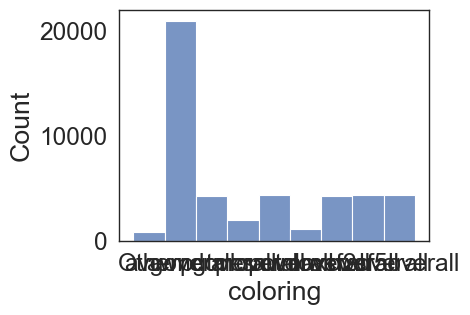

In [43]:
sns.histplot(plot_df["coloring"])

In [44]:
# coloring=cf["maxdrifti"].stack(runkey=["simkey"])
# fig, ax = plt.subplots()
# palette = "flare_r"
# g=sns.scatterplot(x=x_pca[:,0], y=x_pca[:,1], hue=coloring, palette=palette, marker='.', s=1, edgecolor=None, alpha=1, legend=False)
# # g.legend(loc='upper right', bbox_to_anchor=(1.2, 1.0), ncol=1)
# norm = plt.Normalize(coloring.min(), coloring.max())
# cmap = sns.cubehelix_palette(light=1, as_cmap=True)
# sm = plt.cm.ScalarMappable(cmap=palette, norm=norm)
# sm.set_array([])

# cax = fig.add_axes([ax.get_position().x1+0.05, ax.get_position().y0, 0.06, ax.get_position().height])
# ax.figure.colorbar(sm, cax=cax)

# plt.show()

In [45]:
xlab='PC 1 ({:.1f}%)'.format(100*pca.explained_variance_ratio_[0])
ylab='PC 2 ({:.1f}%)'.format(100*pca.explained_variance_ratio_[1])
plot_df=pd.DataFrame({xlab:x_pca[:,0], ylab:x_pca[:,1], "coloring":cf["maxbhi"].stack(runkey=["simkey"])})
plot_df


,PC 1 (97.8%),PC 2 (1.9%),coloring
0,-87.908392,8.513492,0.25
1,-61.845711,0.490998,0.25
2,-35.514073,-6.432538,0.25
3,-11.060426,0.002057,0.20
4,-2.497717,-8.735219,0.20
...,...,...,...
46521,146.716363,-11.745087,0.10
46522,144.681245,-10.138040,0.10
46523,139.080857,-16.987479,0.10
46524,138.899233,-15.779341,0.10


NameError: name 'coloring' is not defined

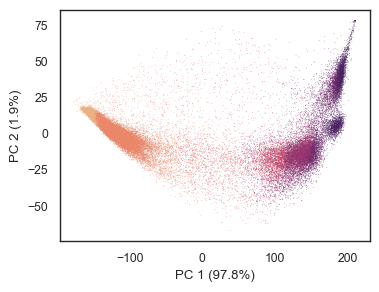

In [46]:
sns.set(rc={"figure.figsize":(4, 3)}) #width=8, height=4
sns.set_theme('paper', 'white', font_scale=1)
# coloring=cf["maxbhi"].stack(runkey=["simkey"])
fig, ax = plt.subplots()
palette = "flare_r"
g=sns.scatterplot(data=plot_df, x=xlab, y=ylab, hue="coloring", palette=palette, marker='.', s=.5, edgecolor=None, alpha=1, legend=False)
# g.legend(loc='upper right', bbox_to_anchor=(1.2, 1.0), ncol=1)
sns.set(rc={"figure.figsize":(4, 1)}) #width=8, height=4

norm = plt.Normalize(coloring.min(), coloring.max())
cmap = sns.cubehelix_palette(light=1, as_cmap=True)
sm = plt.cm.ScalarMappable(cmap=palette, norm=norm)
sm.set_array([])

cax = fig.add_axes([ax.get_position().x1+0.05, ax.get_position().y0, 0.06, ax.get_position().height])
ax.figure.colorbar(sm, cax=cax, label="Max BH")
g.set_xticks([])
g.set_yticks([])
fig.savefig("../Figures/F4E_PCAbyMaxBH.pdf")

#label x axis
# ax.figure.axes[1].set_xlabel('PC 1 ({:.1f}%)'.format(100*pca.explained_variance_ratio_[0])) 
# ax.figure.axes[1].set_ylabel('PC 2 ({:.1f}%)'.format(100*pca.explained_variance_ratio_[1]))
# ax.figure.axes[1].set(position='left')
plt.show()

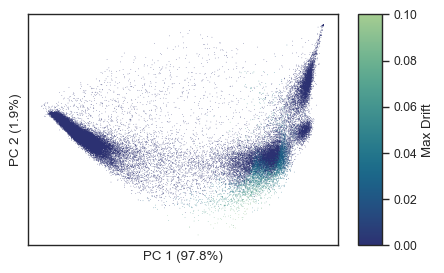

In [ ]:
sns.set(rc={"figure.figsize":(4, 3)}) #width=8, height=4
sns.set_theme('paper', 'white', font_scale=1)

xlab='PC 1 ({:.1f}%)'.format(100*pca.explained_variance_ratio_[0])
ylab='PC 2 ({:.1f}%)'.format(100*pca.explained_variance_ratio_[1])
plot_df=pd.DataFrame({xlab:x_pca[:,0], ylab:x_pca[:,1], "coloring":cf["maxdrifti"].stack(runkey=["simkey"])})
plot_df
# coloring=cf["maxbhi"].stack(runkey=["simkey"])
fig, ax = plt.subplots()
palette = "crest_r"
g=sns.scatterplot(data=plot_df, x=xlab, y=ylab, hue="coloring", palette=palette, marker='.', s=.5, edgecolor=None, alpha=1, legend=False)
# g.legend(loc='upper right', bbox_to_anchor=(1.2, 1.0), ncol=1)

norm = plt.Normalize(coloring.min(), .1)
# 
cmap = sns.cubehelix_palette(light=1, as_cmap=True)
sm = plt.cm.ScalarMappable(cmap=palette, norm=norm)
sm.set_array([])

cax = fig.add_axes([ax.get_position().x1+0.05, ax.get_position().y0, 0.06, ax.get_position().height])
ax.figure.colorbar(sm, cax=cax, label="Max Drift")
g.set_xticks([])
g.set_yticks([])
fig.savefig("../Figures/F4F_PCAbyMaxDrift.pdf")
#label x axis
# ax.figure.axes[1].set_xlabel('PC 1 ({:.1f}%)'.format(100*pca.explained_variance_ratio_[0])) 
# ax.figure.axes[1].set_ylabel('PC 2 ({:.1f}%)'.format(100*pca.explained_variance_ratio_[1]))
# ax.figure.axes[1].set(position='left')
plt.show()
#label x axis
# ax.figure.axes[1].set_xlabel('PC 1 ({:.1f}%)'.format(100*pca.explained_variance_ratio_[0])) 
# ax.figure.axes[1].set_ylabel('PC 2 ({:.1f}%)'.format(100*pca.explained_variance_ratio_[1]))
# ax.figure.axes[1].set(position='left')
plt.show()

In [ ]:
ax.figure.axes

[<Axes: >, <Axes: >]

In [ ]:
# pca.explained_variance_ratio_
x1=px.scatter(x=x_pca[:,2], y=x_pca[:,3], color=dfs["variable"])
x1.layout.xaxis.title.text=('PC 3 ({:.1f}%)'.format(100*pca.explained_variance_ratio_[2]))
x1.layout.yaxis.title.text=('PC 4 ({:.1f}%)'.format(100*pca.explained_variance_ratio_[3]))
x1

In [ ]:
dfs["variable"]

<xarray.DataArray 'variable' (runkey: 46526)>
array(['PARMaximum', 'PARMaximum', 'PARMaximum', ..., 'wsf5overall',
       'wsf5overall', 'wsf5overall'], dtype=object)
Coordinates:
    variable    (runkey) object 'PARMaximum' 'PARMaximum' ... 'wsf5overall'
    siteID      (runkey) object 'ARIK' 'COMO' ... 'station USW00094985'
    chunk       (runkey) int32 0 0 0 0 0 0 0 0 0 0 0 0 ... 6 6 6 6 6 6 6 6 6 6 6
    matureage   int32 10
    envmeanvar  float64 0.3
    birthrate   int32 40
    envvar      float64 0.3
  * runkey      (runkey) object MultiIndex
  * simkey      (runkey) int64 0 1 2 3 4 5 ... 46521 46522 46523 46524 46525

In [47]:
dfs.unstack()["drift"]
dfs.unstack()["bet-hedging"]

<xarray.DataArray 'bet-hedging' (bet-hedging: 11)>
array([0.  , 0.05, 0.1 , 0.15, 0.2 , 0.25, 0.3 , 0.35, 0.4 , 0.45, 0.5 ])
Coordinates:
  * bet-hedging  (bet-hedging) float64 0.0 0.05 0.1 0.15 ... 0.35 0.4 0.45 0.5
    matureage    int32 10
    envmeanvar   float64 0.3
    birthrate    int32 40
    envvar       float64 0.3

In [48]:
dfs.unstack()["drift"]

<xarray.DataArray 'drift' (drift: 11)>
array([0.  , 0.01, 0.02, 0.03, 0.04, 0.05, 0.06, 0.07, 0.08, 0.09, 0.1 ])
Coordinates:
  * drift       (drift) float64 0.0 0.01 0.02 0.03 0.04 ... 0.07 0.08 0.09 0.1
    matureage   int32 10
    envmeanvar  float64 0.3
    birthrate   int32 40
    envvar      float64 0.3

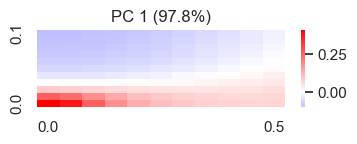

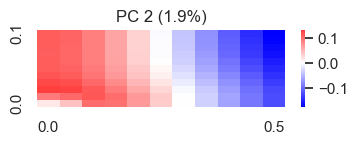

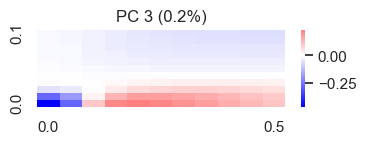

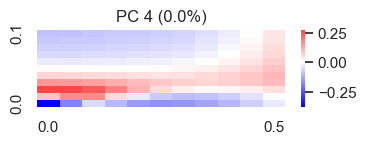

In [49]:
for PCi in range(4):  

    cur_PC = pca.components_[PCi].reshape((11, 11))

    plot_pc_df = pd.DataFrame(cur_PC,
    index=dfs.unstack()["drift"], columns=dfs.unstack()["bet-hedging"])
    # reorder rows so that y axis is increasing in the heatmap
    plot_pc_df = plot_pc_df.iloc[::-1, :]
    
    fig=plt.figure()
    plt.title(f'PC {PCi+1}' + ' ({:.1f}%)'.format(100*pca.explained_variance_ratio_[PCi]))
    sns.heatmap(plot_pc_df, center=0, cmap='bwr', xticklabels=10, yticklabels=10)
    plt.show()
    fig.savefig(f'../Figures/F4G_PC{PCi+1}.pdf')

In [50]:
x_pca[:,0].shape

(46526,)

In [51]:
bhdf=c["maxbhi"].to_dataframe()
ddf=c["maxdrifti"].to_dataframe()
ddf.reset_index()

,envmeanvar,matureage,simkey,variable,siteID,chunk,birthrate,envvar,maxdrifti
0,0.1,10,0,PARMaximum,ARIK,0,40,0.3,0.00
1,0.1,10,1,PARMaximum,COMO,0,40,0.3,0.00
2,0.1,10,2,PARMaximum,GUIL,0,40,0.3,0.00
3,0.1,10,3,PARMaximum,HOPB,0,40,0.3,0.00
4,0.1,10,4,PARMaximum,LECO,0,40,0.3,0.00
...,...,...,...,...,...,...,...,...,...
418729,0.3,360,46521,wsf5overall,station USW00094967,6,40,0.3,0.02
418730,0.3,360,46522,wsf5overall,station USW00094971,6,40,0.3,0.02
418731,0.3,360,46523,wsf5overall,station USW00094973,6,40,0.3,0.02
418732,0.3,360,46524,wsf5overall,station USW00094978,6,40,0.3,0.02


In [52]:
mdf=pd.merge(bhdf.reset_index(), ddf.reset_index())

In [53]:
mdf.to_csv("driftandbh_ideal_strategies.csv")

In [54]:
# c=pd.read_csv('driftmasterfile.csv')

In [55]:
c

<xarray.Dataset>
Dimensions:      (simkey: 46526, day: 1000, bet-hedging: 11, drift: 11,
                  envmeanvar: 3, matureage: 3)
Coordinates:
    variable     (simkey) object 'PARMaximum' 'PARMaximum' ... 'wsf5overall'
    siteID       (simkey) object 'ARIK' 'COMO' ... 'station USW00094985'
    chunk        (simkey) int32 0 0 0 0 0 0 0 0 0 0 0 ... 6 6 6 6 6 6 6 6 6 6 6
  * day          (day) int32 0 1 2 3 4 5 6 7 ... 992 993 994 995 996 997 998 999
  * bet-hedging  (bet-hedging) float64 0.0 0.05 0.1 0.15 ... 0.35 0.4 0.45 0.5
  * drift        (drift) float64 0.0 0.01 0.02 0.03 0.04 ... 0.07 0.08 0.09 0.1
  * matureage    (matureage) int32 10 60 360
  * envmeanvar   (envmeanvar) float64 0.1 0.2 0.3
    birthrate    int32 40
    envvar       float64 0.3
Dimensions without coordinates: simkey
Data variables:
    envi         (day, simkey) float64 -1.673 1.925 1.012 ... 2.166 2.81 -0.6664
    maxdrifti    (envmeanvar, matureage, simkey) float64 0.0 0.0 ... 0.02 0.01
    maxbhi       (envmeanvar, matureage, simkey) float64 0.05 0.0 ... 0.05 0.0
    df           (matureage, envmeanvar, bet-hedging, drift, simkey) float64 ...

In [56]:
cvar=c["maxdrifti"].unstack().groupby("variable").mean()
cvar

<xarray.DataArray 'maxdrifti' (envmeanvar: 3, matureage: 3, variable: 35)>
array([[[0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00,
         0.00000000e+00, 0.00000000e+00, 1.43499474e-06, 0.00000000e+00,
         0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00,
         0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00,
         0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 8.48726910e-05,
         0.00000000e+00, 0.00000000e+00, 3.30722367e-04, 0.00000000e+00,
         0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00,
         0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00,
         0.00000000e+00, 0.00000000e+00, 0.00000000e+00],
        [7.69230769e-04, 7.69230769e-04, 7.69230769e-04, 7.69230769e-04,
         0.00000000e+00, 0.00000000e+00, 1.14799579e-05, 0.00000000e+00,
         0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00,
         0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00,
         0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 1.89715427e-04,
         0.00000000e+00, 0.00000000e+00, 1.56657963e-03, 0.00000000e+00,
         0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00,
         0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00,
         0.00000000e+00, 0.00000000e+00, 4.62641684e-06],
        [1.00000000e-02, 9.23076923e-03, 7.69230769e-03, 6.92307692e-03,
         3.16666667e-03, 3.00000000e-03, 9.67760452e-03, 1.41367323e-04,
...
         0.00000000e+00, 0.00000000e+00, 6.00000000e-03, 8.00000000e-03,
         1.00000000e-02, 9.94936709e-03, 8.94749017e-03],
        [1.92307692e-02, 2.07692308e-02, 2.00000000e-02, 2.00000000e-02,
         5.13333333e-02, 5.23333333e-02, 2.12556204e-02, 2.29571263e-02,
         1.96078431e-02, 1.96078431e-02, 2.14285714e-02, 1.16666667e-02,
         2.00000000e-02, 1.76923077e-02, 1.85074627e-02, 1.89552239e-02,
         1.92000000e-02, 1.86000000e-02, 1.60000000e-02, 3.10034948e-03,
         2.18799909e-03, 2.10526316e-02, 3.09312446e-02, 3.22222222e-02,
         7.83636364e-02, 7.85454545e-02, 2.03698535e-02, 1.28089888e-02,
         1.40000000e-02, 1.60000000e-02, 1.80000000e-02, 1.80000000e-02,
         6.75000000e-02, 1.68584580e-02, 1.61623872e-02],
        [2.61538462e-02, 2.53846154e-02, 2.46153846e-02, 2.69230769e-02,
         5.85000000e-02, 5.91666667e-02, 2.82225199e-02, 3.13974508e-02,
         2.56862745e-02, 2.62745098e-02, 3.14285714e-02, 1.83333333e-02,
         2.15384615e-02, 2.53846154e-02, 2.56716418e-02, 2.61194030e-02,
         2.20000000e-02, 2.22000000e-02, 2.40000000e-02, 4.97753370e-03,
         5.88409765e-03, 2.78947368e-02, 3.54221062e-02, 3.55555556e-02,
         8.41818182e-02, 8.45454545e-02, 2.77622703e-02, 2.05617978e-02,
         2.40000000e-02, 2.40000000e-02, 2.80000000e-02, 2.40000000e-02,
         7.50000000e-02, 2.38665132e-02, 2.28614388e-02]]])
Coordinates:
  * matureage   (matureage) int32 10 60 360
  * envmeanvar  (envmeanvar) float64 0.1 0.2 0.3
    birthrate   int32 40
    envvar      float64 0.3
  * variable    (variable) object 'PARMaximum' 'PARMean' ... 'wsf5overall'

In [57]:
cvardf=cvar.to_dataframe()
cvardf

birthrate  envvar  maxdrifti
envmeanvar matureage variable                                  
0.1        10        PARMaximum           40     0.3   0.000000
                     PARMean              40     0.3   0.000000
                     PARStdErMean         40     0.3   0.000000
                     PARVariance          40     0.3   0.000000
                     RHMaximum            40     0.3   0.000000
...                                      ...     ...        ...
0.3        360       uPARMinimum          40     0.3   0.028000
                     uPARVariance         40     0.3   0.024000
                     wdmvoverall          40     0.3   0.075000
                     wsf2overall          40     0.3   0.023867
                     wsf5overall          40     0.3   0.022861

[315 rows x 3 columns]

In [58]:
sortedsites

['     BSk',
 '     Dfc',
 '      Af',
 '     Dfb',
 '     Cfa',
 '     Cfa',
 '     Csb',
 '     Cfa',
 '     Cfa',
 '     Cfa',
 '     Cfa',
 '     Cfa',
 '     Cfa',
 '     BSk',
 '     Dfc',
 '      Af',
 '     Dfb',
 '     Cfa',
 '     Cfa',
 '     Csb',
 '     Cfa',
 '     Cfa',
 '     Cfa',
 '     Cfa',
 '     Cfa',
 '     Cfa',
 '     BSk',
 '     Dfc',
 '      Af',
 '     Dfb',
 '     Cfa',
 '     Cfa',
 '     Csb',
 '     Cfa',
 '     Cfa',
 '     Cfa',
 '     Cfa',
 '     Cfa',
 '     Cfa',
 '     BSk',
 '     Dfc',
 '      Af',
 '     Dfb',
 '     Cfa',
 '     Cfa',
 '     Csb',
 '     Cfa',
 '     Cfa',
 '     Cfa',
 '     Cfa',
 '     Cfa',
 '     Cfa',
 '     Csb',
 '     BSk',
 '     Cfa',
 '      ET',
 '     Dfb',
 '     Cfa',
 '     Dsc',
 '     Dsc',
 '     Cfa',
 '     Dfc',
 '     BSk',
 '     Dfb',
 '     Dfb',
 '     Dsc',
 '     Cfa',
 '     Cfa',
 '     Dfb',
 '     Dsc',
 '     Dfb',
 '     Cfa',
 '     BSk',
 '     Cfa',
 '     Cfa',
 '     Cfa',
 '     Dfb',

In [59]:
mdf

,envmeanvar,matureage,simkey,variable,siteID,chunk,birthrate,envvar,maxbhi,maxdrifti
0,0.1,10,0,PARMaximum,ARIK,0,40,0.3,0.05,0.00
1,0.1,10,1,PARMaximum,COMO,0,40,0.3,0.00,0.00
2,0.1,10,2,PARMaximum,GUIL,0,40,0.3,0.00,0.00
3,0.1,10,3,PARMaximum,HOPB,0,40,0.3,0.00,0.00
4,0.1,10,4,PARMaximum,LECO,0,40,0.3,0.00,0.00
...,...,...,...,...,...,...,...,...,...,...
418729,0.3,360,46521,wsf5overall,station USW00094967,6,40,0.3,0.00,0.02
418730,0.3,360,46522,wsf5overall,station USW00094971,6,40,0.3,0.00,0.02
418731,0.3,360,46523,wsf5overall,station USW00094973,6,40,0.3,0.15,0.02
418732,0.3,360,46524,wsf5overall,station USW00094978,6,40,0.3,0.05,0.02


In [76]:
#merge mdf with simkeykccindex on simkey column
mdf_kcc=pd.merge(mdf, simkeykccindex)
mdf_kcc

,envmeanvar,matureage,simkey,variable,siteID,chunk,birthrate,envvar,maxbhi,maxdrifti,KCC
0,0.1,10,0,PARMaximum,ARIK,0,40,0.3,0.05,0.00,BSk
1,0.1,60,0,PARMaximum,ARIK,0,40,0.3,0.10,0.00,BSk
2,0.1,360,0,PARMaximum,ARIK,0,40,0.3,0.05,0.01,BSk
3,0.2,10,0,PARMaximum,ARIK,0,40,0.3,0.15,0.00,BSk
4,0.2,60,0,PARMaximum,ARIK,0,40,0.3,0.15,0.01,BSk
...,...,...,...,...,...,...,...,...,...,...,...
418729,0.2,60,46525,wsf5overall,station USW00094985,6,40,0.3,0.00,0.00,Dfb
418730,0.2,360,46525,wsf5overall,station USW00094985,6,40,0.3,0.00,0.00,Dfb
418731,0.3,10,46525,wsf5overall,station USW00094985,6,40,0.3,0.05,0.00,Dfb
418732,0.3,60,46525,wsf5overall,station USW00094985,6,40,0.3,0.00,0.01,Dfb


In [78]:
mdfg=mdf.groupby(["variable", "envmeanvar", "matureage"]).mean()
# mdfg.mean()
# mdfg.reset_index()

mdfg_site=mdf_kcc.groupby(["KCC", "envmeanvar", "matureage"]).mean()
# mdfg.mean()
mdfg_site.reset_index()

/var/folders/s_/7_g1r1fs2wdcxn113q39_gzw0000gn/T/ipykernel_52576/1264091459.py:1: FutureWarning:

The default value of numeric_only in DataFrameGroupBy.mean is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.

/var/folders/s_/7_g1r1fs2wdcxn113q39_gzw0000gn/T/ipykernel_52576/1264091459.py:5: FutureWarning:

The default value of numeric_only in DataFrameGroupBy.mean is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.



,KCC,envmeanvar,matureage,simkey,chunk,birthrate,envvar,maxbhi,maxdrifti
0,Af,0.1,10,16118.036364,2.378409,40.0,0.3,0.004545,0.000000
1,Af,0.1,60,16118.036364,2.378409,40.0,0.3,0.029716,0.000000
2,Af,0.1,360,16118.036364,2.378409,40.0,0.3,0.014261,0.002977
3,Af,0.2,10,16118.036364,2.378409,40.0,0.3,0.085852,0.000250
4,Af,0.2,60,16118.036364,2.378409,40.0,0.3,0.084318,0.005216
...,...,...,...,...,...,...,...,...,...
265,Dwd,0.2,60,10679.250000,2.750000,40.0,0.3,0.187500,0.010000
266,Dwd,0.2,360,10679.250000,2.750000,40.0,0.3,0.128125,0.020000
267,Dwd,0.3,10,10679.250000,2.750000,40.0,0.3,0.293750,0.000000
268,Dwd,0.3,60,10679.250000,2.750000,40.0,0.3,0.300000,0.020000


#  (Figure S4) Here's where we plot the average peak strategy across all sets

## calculate max drift and bet-hedging for each envmeanvar and matureage

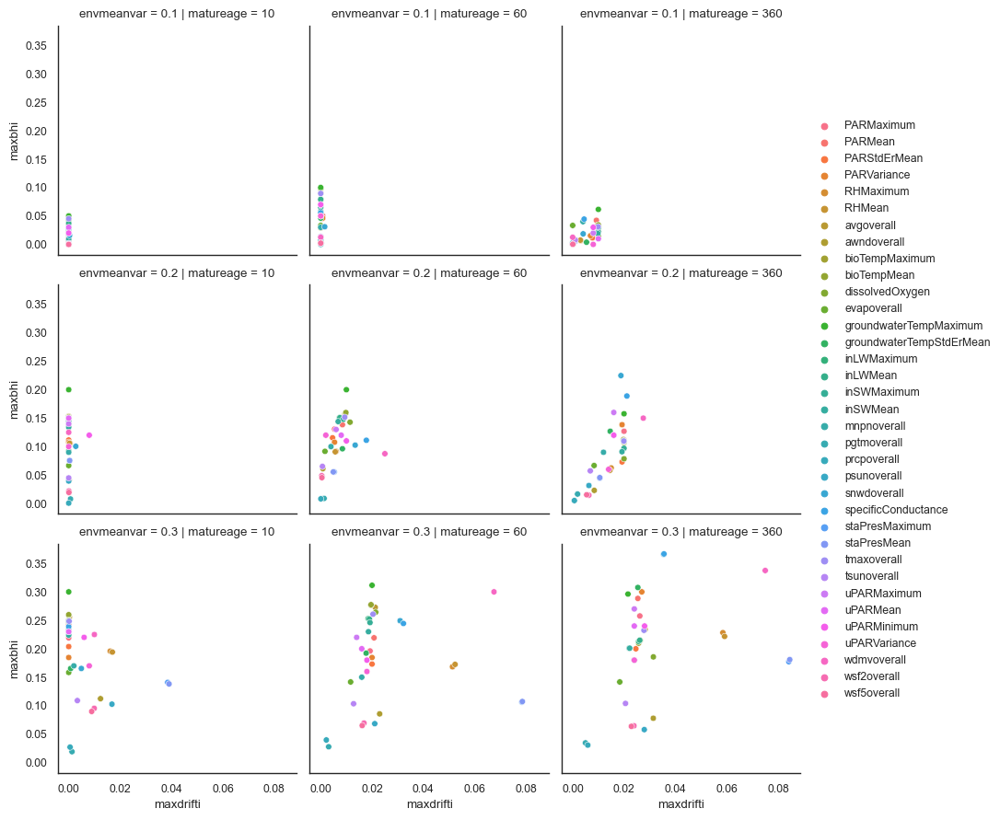

In [64]:

sns.set_theme('paper', 'white', font_scale=1)

g=sns.FacetGrid(mdfg.reset_index(), col="matureage", row="envmeanvar")
g.map(sns.scatterplot, "maxdrifti", "maxbhi", "variable")
g.add_legend()
g.savefig("optdriftvsoptbetbyvar2.pdf")

## Plot by each KCC

In [79]:
mdfg_site.reset_index()

,KCC,envmeanvar,matureage,simkey,chunk,birthrate,envvar,maxbhi,maxdrifti
0,Af,0.1,10,16118.036364,2.378409,40.0,0.3,0.004545,0.000000
1,Af,0.1,60,16118.036364,2.378409,40.0,0.3,0.029716,0.000000
2,Af,0.1,360,16118.036364,2.378409,40.0,0.3,0.014261,0.002977
3,Af,0.2,10,16118.036364,2.378409,40.0,0.3,0.085852,0.000250
4,Af,0.2,60,16118.036364,2.378409,40.0,0.3,0.084318,0.005216
...,...,...,...,...,...,...,...,...,...
265,Dwd,0.2,60,10679.250000,2.750000,40.0,0.3,0.187500,0.010000
266,Dwd,0.2,360,10679.250000,2.750000,40.0,0.3,0.128125,0.020000
267,Dwd,0.3,10,10679.250000,2.750000,40.0,0.3,0.293750,0.000000
268,Dwd,0.3,60,10679.250000,2.750000,40.0,0.3,0.300000,0.020000


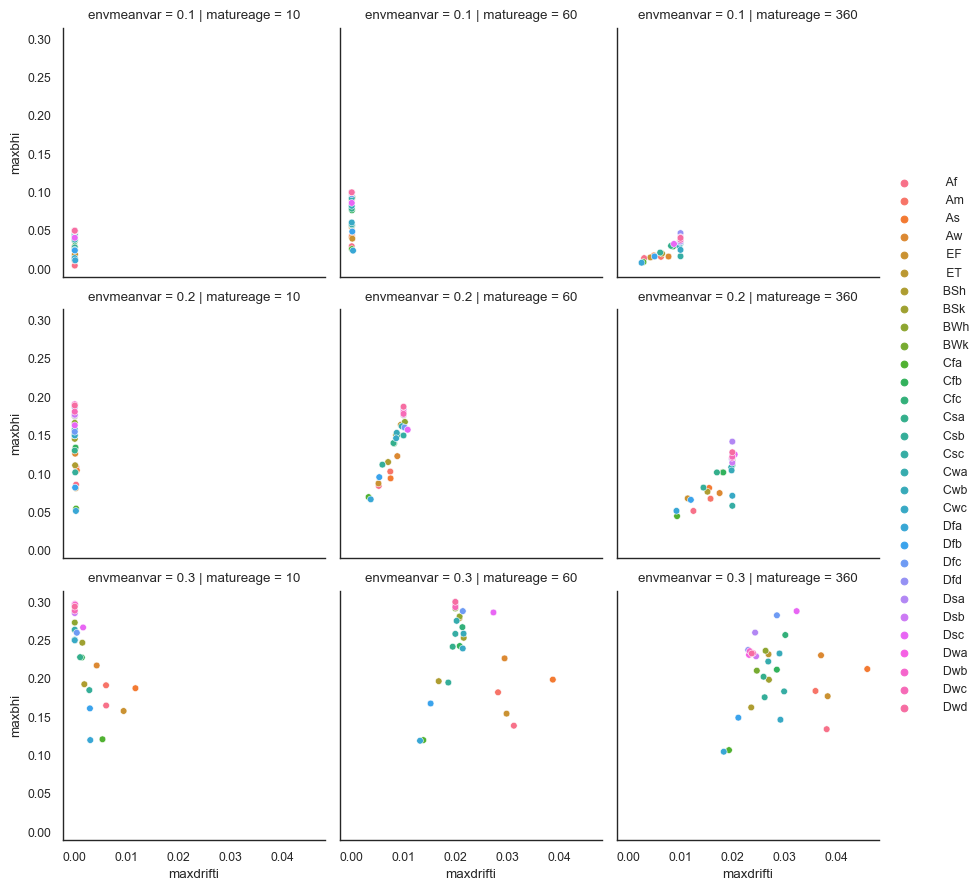

In [81]:
g=sns.FacetGrid(mdfg_site.reset_index(), col="matureage", row="envmeanvar")
g.map(sns.scatterplot, "maxdrifti", "maxbhi", "KCC")
g.add_legend()
g.savefig("optdriftvsoptbetbykcc.pdf")

In [ ]:
mdfgr=mdfg.reset_index()
mdfgr

,variable,envmeanvar,matureage,simkey,chunk,birthrate,envvar,maxbhi,maxdrifti
0,PARMaximum,0.1,10,6.0,0.076923,40.0,0.3,0.011538,0.000000
1,PARMaximum,0.1,60,6.0,0.076923,40.0,0.3,0.050000,0.000769
2,PARMaximum,0.1,360,6.0,0.076923,40.0,0.3,0.023077,0.010000
3,PARMaximum,0.2,10,6.0,0.076923,40.0,0.3,0.138462,0.000000
4,PARMaximum,0.2,60,6.0,0.076923,40.0,0.3,0.130769,0.005385
...,...,...,...,...,...,...,...,...,...
310,wsf5overall,0.2,60,44364.0,2.846866,40.0,0.3,0.045431,0.000472
311,wsf5overall,0.2,360,44364.0,2.846866,40.0,0.3,0.015325,0.005445
312,wsf5overall,0.3,10,44364.0,2.846866,40.0,0.3,0.089799,0.008947
313,wsf5overall,0.3,60,44364.0,2.846866,40.0,0.3,0.065036,0.016162


In [ ]:
a=mdfgr["envmeanvar"]==.3
b=mdfgr["matureage"]==360
a&b
mdfgr_filtered=mdfgr[a&b]
# mdfgr_filtered

In [ ]:
a=px.scatter(mdfgr_filtered, y="maxbhi", x="maxdrifti", color="variable", facet_col="matureage")
a.write_html('dvbh_byvariable.html')

In [ ]:
mdfg=mdf.groupby(["variable", "envmeanvar", "matureage"]).mean()
# mdfg.mean()
# mdfg.reset_index()

mdfg_site=mdf.groupby(["siteID", "envmeanvar", "matureage"]).mean()
# mdfg.mean()
mdfg_site.reset_index()

/var/folders/s_/7_g1r1fs2wdcxn113q39_gzw0000gn/T/ipykernel_52866/2260209295.py:1: FutureWarning:

The default value of numeric_only in DataFrameGroupBy.mean is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.

/var/folders/s_/7_g1r1fs2wdcxn113q39_gzw0000gn/T/ipykernel_52866/2260209295.py:5: FutureWarning:

The default value of numeric_only in DataFrameGroupBy.mean is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.



,siteID,envmeanvar,matureage,simkey,chunk,birthrate,envvar,maxbhi,maxdrifti
0,ABBY,0.1,10,11192.833333,0.333333,40.0,0.3,0.000000,0.000000
1,ABBY,0.1,60,11192.833333,0.333333,40.0,0.3,0.033333,0.000000
2,ABBY,0.1,360,11192.833333,0.333333,40.0,0.3,0.016667,0.003333
3,ABBY,0.2,10,11192.833333,0.333333,40.0,0.3,0.100000,0.000000
4,ABBY,0.2,60,11192.833333,0.333333,40.0,0.3,0.091667,0.006667
...,...,...,...,...,...,...,...,...,...
37840,station ZI000067775,0.2,60,3660.000000,0.000000,40.0,0.3,0.150000,0.010000
37841,station ZI000067775,0.2,360,3660.000000,0.000000,40.0,0.3,0.200000,0.020000
37842,station ZI000067775,0.3,10,3660.000000,0.000000,40.0,0.3,0.250000,0.000000
37843,station ZI000067775,0.3,60,3660.000000,0.000000,40.0,0.3,0.250000,0.020000


In [ ]:
# mdfg=mdf.groupby(["variable", "envmeanvar", "matureage"]).mean()



/var/folders/s_/7_g1r1fs2wdcxn113q39_gzw0000gn/T/ipykernel_52866/1999817229.py:1: FutureWarning:

The default value of numeric_only in DataFrameGroupBy.mean is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.



In [ ]:
mdfg=mdf.groupby(["variable", "envmeanvar", "matureage"]).mean()
# mdfg.mean()
# mdfg.reset_index()

mdfg_site=mdf.groupby(["siteID", "envmeanvar", "matureage"]).mean()
# mdfg.mean()
mdfg_site.reset_index()
# mdfg_site_filtered=mdfg_site[a&b]


/var/folders/s_/7_g1r1fs2wdcxn113q39_gzw0000gn/T/ipykernel_52866/1466633871.py:1: FutureWarning:

The default value of numeric_only in DataFrameGroupBy.mean is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.

/var/folders/s_/7_g1r1fs2wdcxn113q39_gzw0000gn/T/ipykernel_52866/1466633871.py:5: FutureWarning:

The default value of numeric_only in DataFrameGroupBy.mean is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.



,siteID,envmeanvar,matureage,simkey,chunk,birthrate,envvar,maxbhi,maxdrifti
0,ABBY,0.1,10,11192.833333,0.333333,40.0,0.3,0.000000,0.000000
1,ABBY,0.1,60,11192.833333,0.333333,40.0,0.3,0.033333,0.000000
2,ABBY,0.1,360,11192.833333,0.333333,40.0,0.3,0.016667,0.003333
3,ABBY,0.2,10,11192.833333,0.333333,40.0,0.3,0.100000,0.000000
4,ABBY,0.2,60,11192.833333,0.333333,40.0,0.3,0.091667,0.006667
...,...,...,...,...,...,...,...,...,...
37840,station ZI000067775,0.2,60,3660.000000,0.000000,40.0,0.3,0.150000,0.010000
37841,station ZI000067775,0.2,360,3660.000000,0.000000,40.0,0.3,0.200000,0.020000
37842,station ZI000067775,0.3,10,3660.000000,0.000000,40.0,0.3,0.250000,0.000000
37843,station ZI000067775,0.3,60,3660.000000,0.000000,40.0,0.3,0.250000,0.020000


In [ ]:
c["maxdrifti"].to_dataframe().reset_index()

,envmeanvar,matureage,simkey,variable,siteID,chunk,birthrate,envvar,maxdrifti
0,0.1,10,0,PARMaximum,ARIK,0,40,0.3,0.00
1,0.1,10,1,PARMaximum,COMO,0,40,0.3,0.00
2,0.1,10,2,PARMaximum,GUIL,0,40,0.3,0.00
3,0.1,10,3,PARMaximum,HOPB,0,40,0.3,0.00
4,0.1,10,4,PARMaximum,LECO,0,40,0.3,0.00
...,...,...,...,...,...,...,...,...,...
418729,0.3,360,46521,wsf5overall,station USW00094967,6,40,0.3,0.02
418730,0.3,360,46522,wsf5overall,station USW00094971,6,40,0.3,0.02
418731,0.3,360,46523,wsf5overall,station USW00094973,6,40,0.3,0.02
418732,0.3,360,46524,wsf5overall,station USW00094978,6,40,0.3,0.02


In [ ]:

px.scatter(c["maxdrifti"].to_dataframe().reset_index()["simkey"], x="matureage", y="envmeanvar")

In [ ]:
c["simkey"].to_dataframe().to_csv("simkey.csv")

In [ ]:
sns.set_theme('paper', 'whitegrid', font_scale=1)
g=sns.FacetGrid(subsetdf, col="matureage", row="Period", margin_titles=True,
                 row_order=period, height=2, aspect=1)
g.map_dataframe(draw_heatmap, "drift", "bet-hedging", "sim_results", cmap="magma", cbar=False, square=True, xticklabels=10, yticklabels=10)
g.fig.savefig("../Figures/f3C_matureage x period heatmaps.pdf")

In [ ]:
def draw_heatmap(*args, **kwargs):
    data = kwargs.pop('data')
    d = data.pivot(index=args[1], columns=args[0], values=args[2])
    sns.heatmap(d, **kwargs).invert_yaxis()

In [ ]:
matrix=c["df"].sel({"matureage":360, "envmeanvar":.3, "simkey":selected}).squeeze()
stratmap=pd.DataFrame(matrix,  columns=pd.Series(data=matrix["bet-hedging"].values, name="Bet-Hedging"), index=pd.Series(data=matrix["drift"].values, name="Drift"))


<xarray.DataArray 'df' (bet-hedging: 11, drift: 11)>
array([[9.64315567e-214, 2.72662922e-084, 6.33314390e-063,
        1.19447592e-059, 1.53610601e-060, 2.95880223e-063,
        5.51099323e-067, 2.37561481e-071, 3.90582672e-076,
        3.40241290e-081, 1.99009761e-086],
       [1.81808970e-182, 1.19853578e-078, 5.29000069e-061,
        1.22101431e-058, 5.95375454e-060, 6.88158889e-063,
        9.57015479e-067, 3.45310770e-071, 5.06774542e-076,
        4.09424707e-081, 2.27451653e-086],
       [7.18933799e-180, 3.20066613e-074, 5.00683636e-059,
        2.13503585e-057, 3.76964187e-059, 2.31162523e-062,
        2.14903391e-066, 5.97485179e-071, 7.38469621e-076,
        5.31702782e-081, 2.73073669e-086],
       [1.20237035e-179, 9.14365689e-073, 4.34009230e-058,
        1.26526181e-056, 1.48571710e-058, 6.41295454e-062,
        4.53628644e-066, 1.02868345e-070, 1.09512724e-075,
        7.07292523e-081, 3.35608709e-086],
       [9.63690387e-180, 2.46185954e-072, 1.02767890e-057,
        3.15587802e-056, 3.32752203e-058, 1.23776134e-061,
        7.60334240e-066, 1.53034152e-070, 1.48009514e-075,
        8.86503472e-081, 3.96746469e-086],
...
       [4.55585175e-180, 2.64330643e-072, 1.43143302e-057,
        6.82310137e-056, 7.38010035e-058, 2.41114537e-061,
        1.28222197e-065, 2.28166479e-070, 1.99832514e-075,
        1.10606827e-080, 4.64959222e-086],
       [3.18709820e-180, 2.10810744e-072, 1.33395032e-057,
        8.20990331e-056, 9.38065181e-058, 2.94062476e-061,
        1.47396859e-065, 2.49835957e-070, 2.11304324e-075,
        1.14113029e-080, 4.71276016e-086],
       [2.32111260e-180, 1.63477633e-072, 1.19193618e-057,
        9.19904022e-056, 1.11528060e-057, 3.41030443e-061,
        1.62830643e-065, 2.64364272e-070, 2.16827761e-075,
        1.14716146e-080, 4.67314443e-086],
       [1.76721743e-180, 1.27980247e-072, 1.05577548e-057,
        9.82131301e-056, 1.25653789e-057, 3.79467476e-061,
        1.74739166e-065, 2.73858977e-070, 2.18854386e-075,
        1.13822358e-080, 4.58634636e-086],
       [1.40379218e-180, 1.02676397e-072, 9.41089194e-058,
        1.01693666e-055, 1.36138150e-057, 4.09032169e-061,
        1.83548647e-065, 2.79844211e-070, 2.18958873e-075,
        1.12291732e-080, 4.48531221e-086]])
Coordinates:
    variable     object 'avgoverall'
    siteID       object 'station USR0000AKAI'
    chunk        int32 5
  * bet-hedging  (bet-hedging) float64 0.0 0.05 0.1 0.15 ... 0.35 0.4 0.45 0.5
  * drift        (drift) float64 0.0 0.01 0.02 0.03 0.04 ... 0.07 0.08 0.09 0.1
    matureage    int32 360
    envmeanvar   float64 0.3
    birthrate    int32 40
    envvar       float64 0.3

In [ ]:
c

<xarray.Dataset>
Dimensions:      (simkey: 46526, day: 1000, bet-hedging: 11, drift: 11,
                  envmeanvar: 3, matureage: 3)
Coordinates:
    variable     (simkey) object 'PARMaximum' 'PARMaximum' ... 'wsf5overall'
    siteID       (simkey) object 'ARIK' 'COMO' ... 'station USW00094985'
    chunk        (simkey) int32 0 0 0 0 0 0 0 0 0 0 0 ... 6 6 6 6 6 6 6 6 6 6 6
  * day          (day) int32 0 1 2 3 4 5 6 7 ... 992 993 994 995 996 997 998 999
  * bet-hedging  (bet-hedging) float64 0.0 0.05 0.1 0.15 ... 0.35 0.4 0.45 0.5
  * drift        (drift) float64 0.0 0.01 0.02 0.03 0.04 ... 0.07 0.08 0.09 0.1
  * matureage    (matureage) int32 10 60 360
  * envmeanvar   (envmeanvar) float64 0.1 0.2 0.3
    birthrate    int32 40
    envvar       float64 0.3
Dimensions without coordinates: simkey
Data variables:
    envi         (day, simkey) float64 -1.673 1.925 1.012 ... 2.166 2.81 -0.6664
    maxdrifti    (envmeanvar, matureage, simkey) float64 0.0 0.0 ... 0.02 0.01
    maxbhi       (envmeanvar, matureage, simkey) float64 0.05 0.0 ... 0.05 0.0
    df           (matureage, envmeanvar, bet-hedging, drift, simkey) float64 ...

## Plots for Figure 4 A-B

In [ ]:
31667

31667

[31667]
prcpoverall station USW00003816


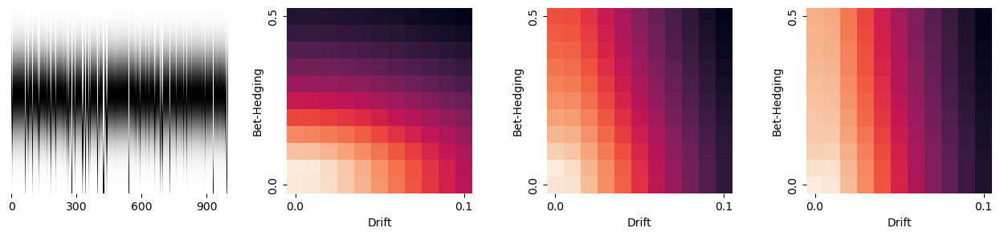

In [ ]:
selected=np.random.choice(c["maxdrifti"].to_dataframe().reset_index()["simkey"],1)
print(selected)
print(c["variable"][selected].values[0],c["siteID"][selected].values[0])

f,axs=plt.subplots(1,4, figsize=(16,3))
sns.heatmap(sd.meantofullenvi(c["envi"][:, selected], .2, .3), cmap="gray_r", yticklabels=False, xticklabels=300,ax=axs[0], cbar=False)

matrix=c["df"].sel({"matureage":10, "envmeanvar":.3, "simkey":selected}).squeeze()
stratmap=pd.DataFrame(matrix,  index=pd.Series(data=matrix["bet-hedging"].values, name="Bet-Hedging"), columns=pd.Series(data=matrix["drift"].values, name="Drift"))
sns.heatmap(np.log10(stratmap), ax=axs[1], cbar=False, square=True, yticklabels=10, xticklabels=10)
axs[1].invert_yaxis()

matrix=c["df"].sel({"matureage":60, "envmeanvar":.3, "simkey":selected}).squeeze()
stratmap=pd.DataFrame(matrix,  index=pd.Series(data=matrix["bet-hedging"].values, name="Bet-Hedging"), columns=pd.Series(data=matrix["drift"].values, name="Drift"))
sns.heatmap(np.log10(stratmap), ax=axs[2], cbar=False, square=True, yticklabels=10, xticklabels=10)
axs[2].invert_yaxis()

matrix=c["df"].sel({"matureage":360, "envmeanvar":.3, "simkey":selected}).squeeze()
stratmap=pd.DataFrame(matrix,  index=pd.Series(data=matrix["bet-hedging"].values, name="Bet-Hedging"), columns=pd.Series(data=matrix["drift"].values, name="Drift"))
sns.heatmap(np.log10(stratmap), ax=axs[3], cbar=False, square=True, yticklabels=10, xticklabels=10)
axs[3].invert_yaxis()

wsf5overall station USW00094814


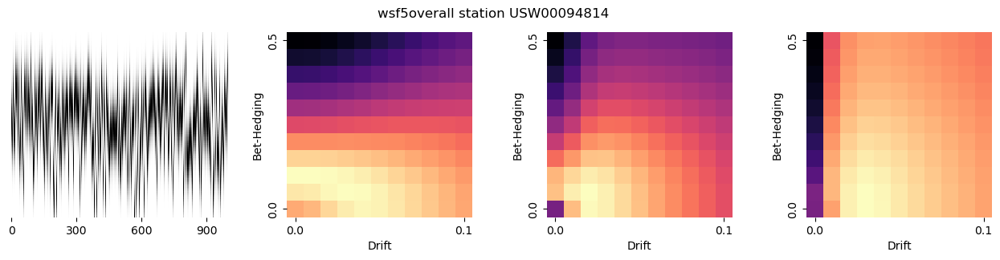

In [ ]:
selected=np.random.choice(c["maxdrifti"].to_dataframe().reset_index()["simkey"],1)
def pickrealworldenvironment(c, selected, envmeanvar=.3, ev=.2):
  print(c["variable"][selected].values[0],c["siteID"][selected].values[0])

  f,axs=plt.subplots(1,4, figsize=(16,3))
  sns.heatmap(sd.meantofullenvi(c["envi"][:, selected], envimeanvariance=envmeanvar, envivariance=ev), cmap="gray_r", yticklabels=False, xticklabels=300,ax=axs[0], cbar=False)

  matrix=c["df"].sel({"matureage":10, "envmeanvar":envmeanvar, "simkey":selected}).squeeze()
  stratmap=pd.DataFrame(matrix,  index=pd.Series(data=matrix["bet-hedging"].values, name="Bet-Hedging"), columns=pd.Series(data=matrix["drift"].values, name="Drift"))
  sns.heatmap(np.log10(stratmap), ax=axs[1], cbar=False, square=True, yticklabels=10, xticklabels=10, cmap="magma")
  axs[1].invert_yaxis()

  matrix=c["df"].sel({"matureage":60, "envmeanvar":envmeanvar, "simkey":selected}).squeeze()
  stratmap=pd.DataFrame(matrix,  index=pd.Series(data=matrix["bet-hedging"].values, name="Bet-Hedging"), columns=pd.Series(data=matrix["drift"].values, name="Drift"))
  sns.heatmap(np.log10(stratmap), ax=axs[2], cbar=False, square=True, yticklabels=10, xticklabels=10, cmap="magma")
  axs[2].invert_yaxis()

  matrix=c["df"].sel({"matureage":360, "envmeanvar":envmeanvar, "simkey":selected}).squeeze()
  stratmap=pd.DataFrame(matrix,  index=pd.Series(data=matrix["bet-hedging"].values, name="Bet-Hedging"), columns=pd.Series(data=matrix["drift"].values, name="Drift"))
  sns.heatmap(np.log10(stratmap), ax=axs[3], cbar=False, square=True, yticklabels=10, xticklabels=10, cmap="magma")
  axs[3].invert_yaxis()
  f.suptitle(c["variable"][selected].values[0]+" "+c["siteID"][selected].values[0])
  return f
f1=pickrealworldenvironment(c, selected)

wsf2overall station USW00025516


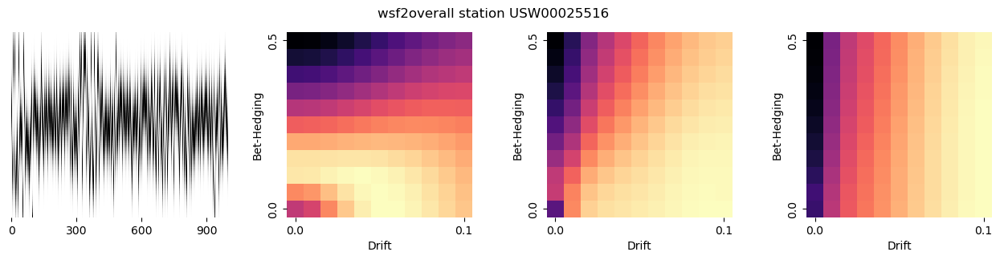

In [ ]:
f1=pickrealworldenvironment(c, [38938], envmeanvar=.3)
f1.savefig("../Figures/F4C_wsf2overallstationUSW00025516.pdf")

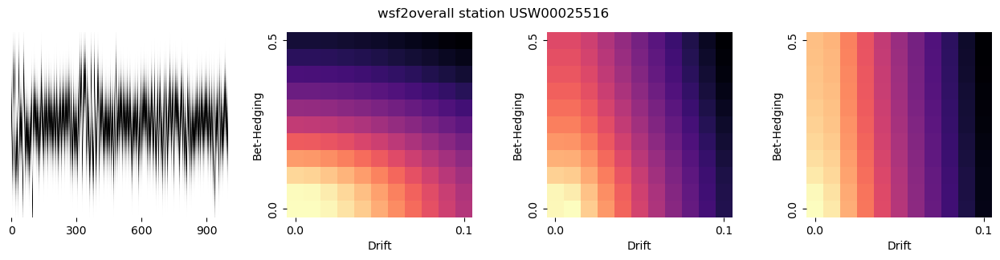

In [ ]:
f1

In [ ]:
all=[42045, 38284, 38938, 39592, 40242, 40889, 41514]

In [ ]:
(c["variable"]=="wsf2overall").values.sum()

4345

In [ ]:
wsf2_25516=np.where(((c["siteID"]=="station USW00025516" ).values*(c["variable"]=="wsf2overall").values))
wsf2_25516[0]

array([38284, 38938, 39592, 40242, 40889, 41514, 42045])

RHMean ARIK


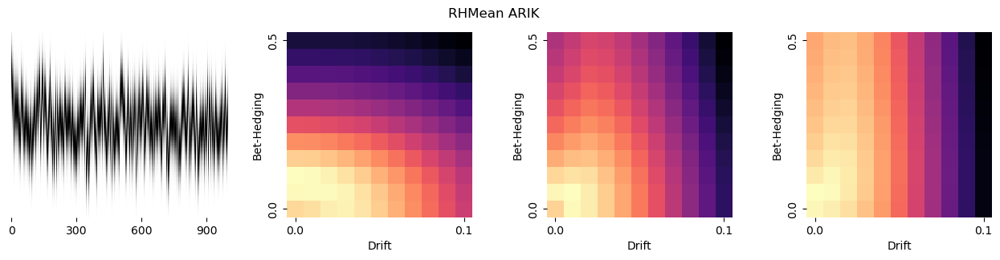

In [ ]:
f1=pickrealworldenvironment(c, [113], envmeanvar=.2)
f1.savefig("../Figures/F4A_1_ARIK_RHMean.pdf")


RHMean ARIK


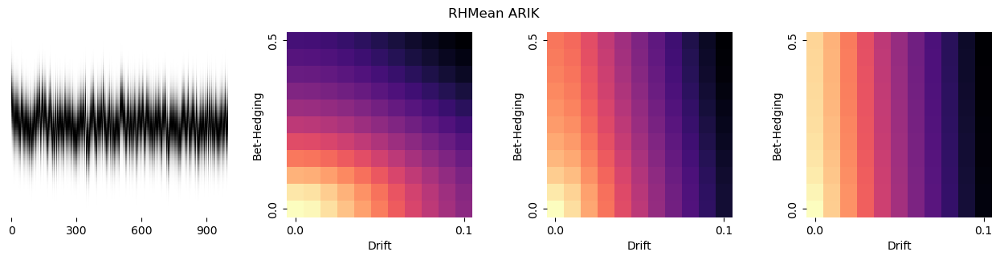

In [ ]:
f2=pickrealworldenvironment(c, [113], envmeanvar=.1)
f2.savefig("../Figures/F4A_2_ARIK_RHMean.pdf")

RHMean ARIK


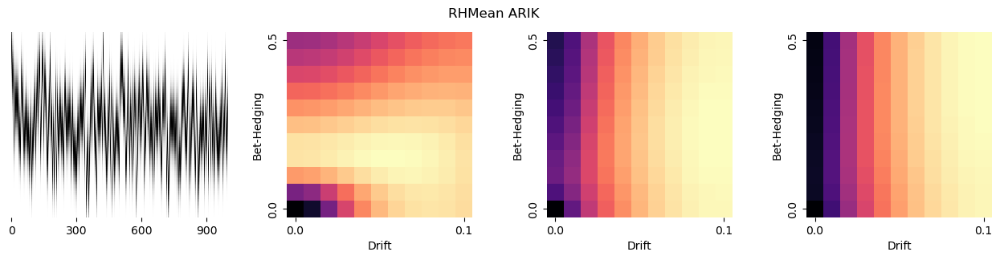

In [ ]:
f2=pickrealworldenvironment(c, [113], envmeanvar=.3)
f2.savefig("../Figures/F4A_3_ARIK_RHMean.pdf")

RHMean ARIK


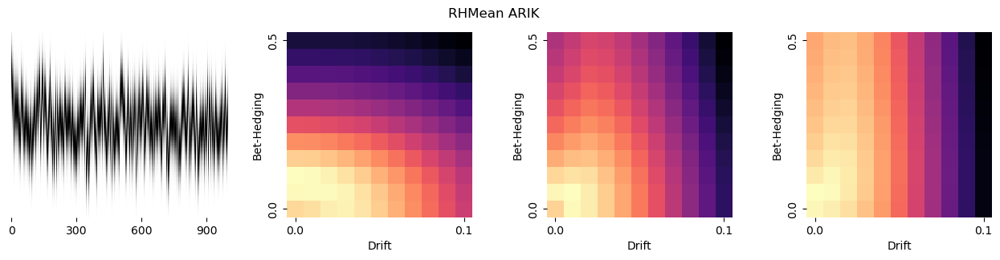

In [ ]:
f1=pickrealworldenvironment(c, [113], envmeanvar=.2)
f1.savefig("../Figures/F4C_ARIK_RHMean.pdf")

38284
wsf2overall station USW00025516
38938
wsf2overall station USW00025516
39592
wsf2overall station USW00025516
40242
wsf2overall station USW00025516
40889
wsf2overall station USW00025516
41514
wsf2overall station USW00025516
42045
wsf2overall station USW00025516


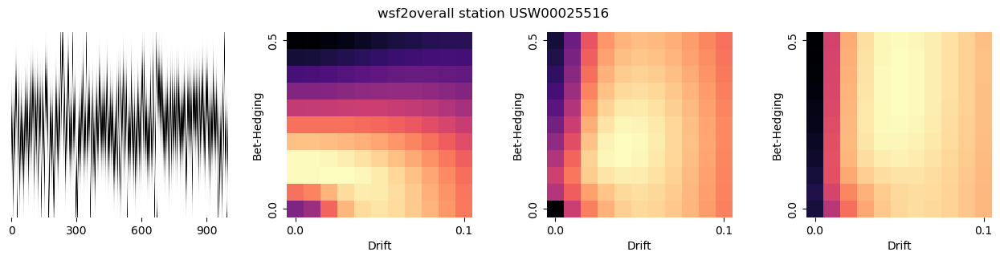

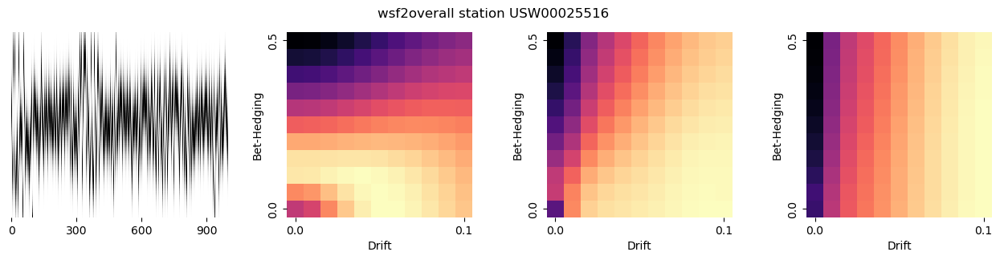

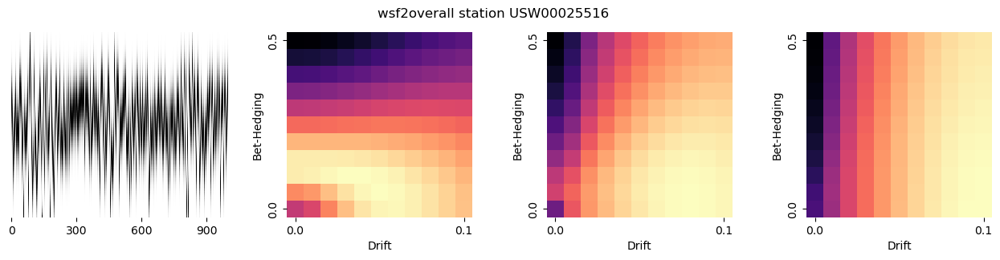

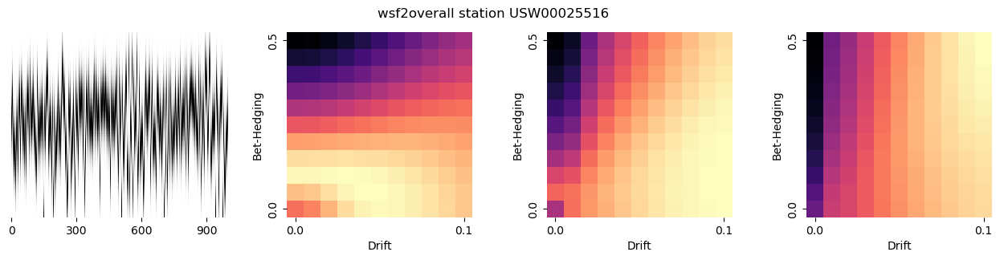

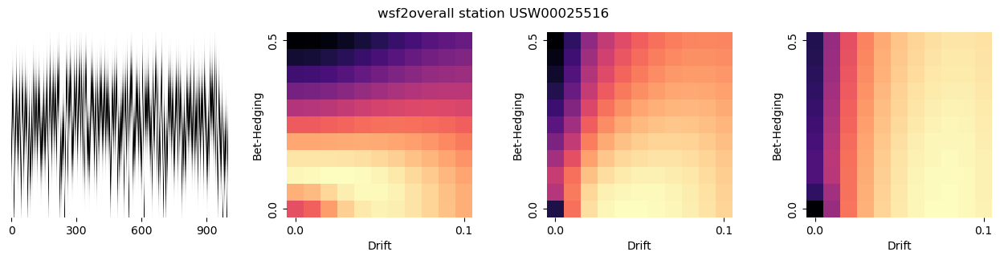

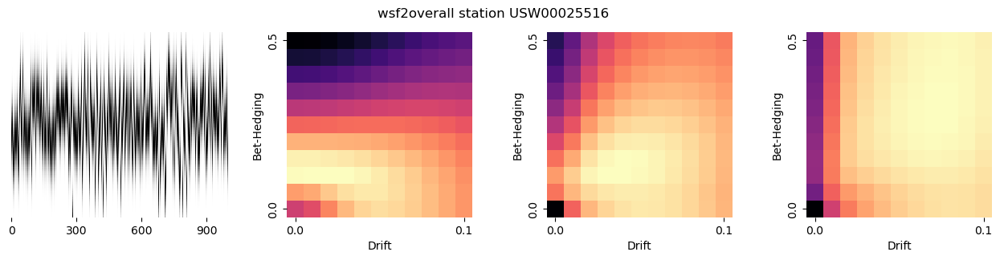

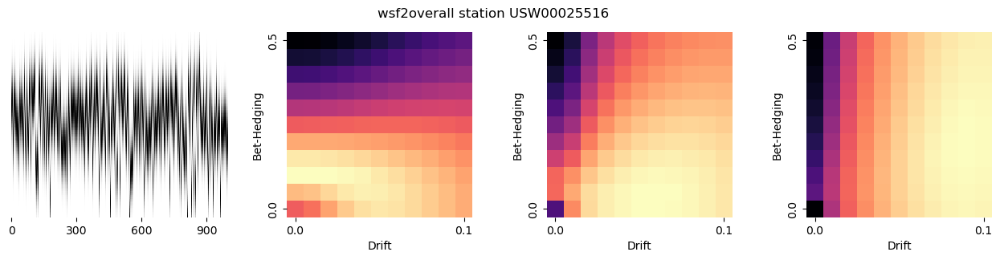

In [ ]:
for i in wsf2_25516[0]:
  print(i)
  f2=pickrealworldenvironment(c, [i], envmeanvar=.3)

avgoverall station ASN00036031


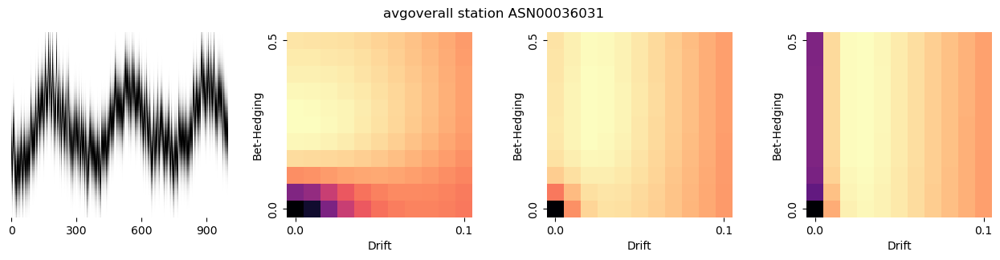

In [ ]:
selected=300 # cool wind choice
f3=pickrealworldenvironment(c, [300], envmeanvar=.3)
f3.savefig("../Figures/F4B2_AvgTempASN00036031.pdf")

prcpoverall station USW00003816


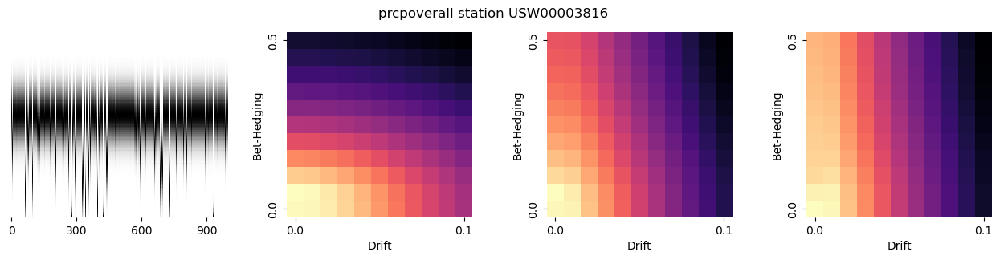

In [ ]:
selected=31667
f4=pickrealworldenvironment(c, [selected], envmeanvar=.3)
f4.savefig("../Figures/F4B4_prcpoverall station USW00003816.pdf")

wsf5overall station USW00012812


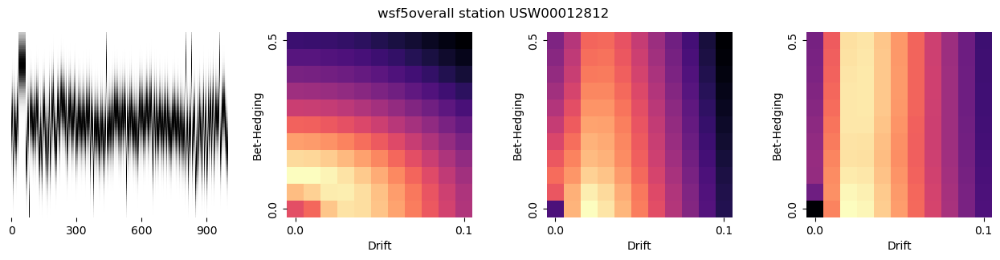

In [ ]:
selected=39592 # cool wind choice
f2=pickrealworldenvironment(c, [42305], envmeanvar=.3)
f2.savefig("../Figures/F4B3_wsf5overall station USW00012812.pdf")

avgoverall station AGM00060566
avgoverall station ASN00036031
avgoverall station BOM00026666
avgoverall station CF000004450
avgoverall station CHM00054618
avgoverall station CHM00059501
avgoverall station FIE00145377
avgoverall station HOM00078708
avgoverall station IN004051800
avgoverall station ITM00016400
avgoverall station KNM00047025
avgoverall station MA000067083
avgoverall station MXM00076402
avgoverall station NOM00001389
avgoverall station ROE00108896
avgoverall station RSM00023734
avgoverall station RSM00027402
avgoverall station RSM00029645
avgoverall station RSM00031478
avgoverall station RSM00037126
avgoverall station SPE00119864


/var/folders/s_/7_g1r1fs2wdcxn113q39_gzw0000gn/T/ipykernel_78510/1389424764.py:5: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  f,axs=plt.subplots(1,4, figsize=(16,3))


avgoverall station TH000048564
avgoverall station UPM00033761
avgoverall station USR0000ATAL
avgoverall station USR0000CGYP
avgoverall station USR0000CSEC
avgoverall station USR0000JENS
avgoverall station USR0000OCAB


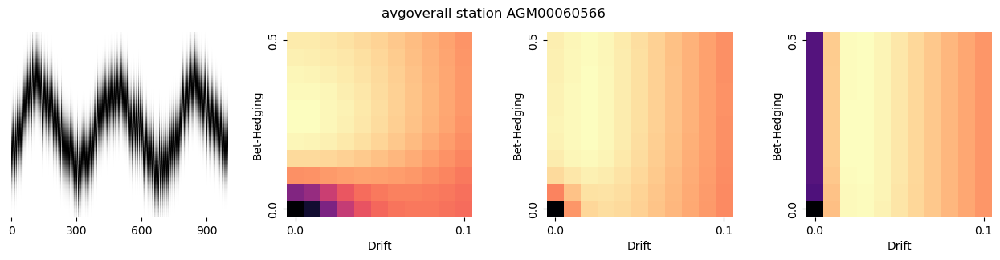

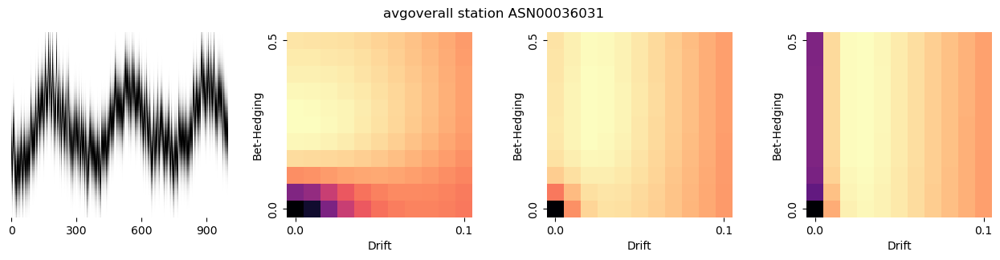

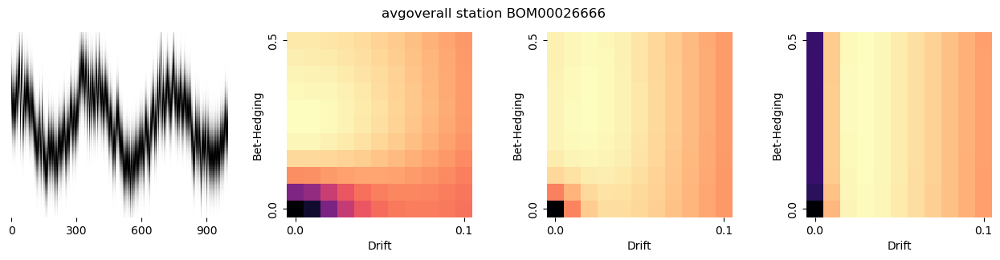

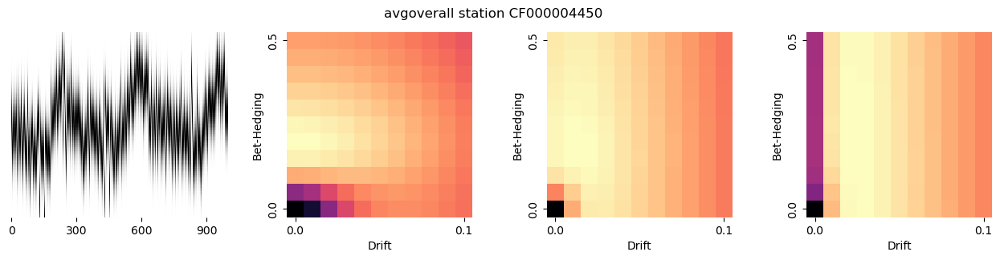

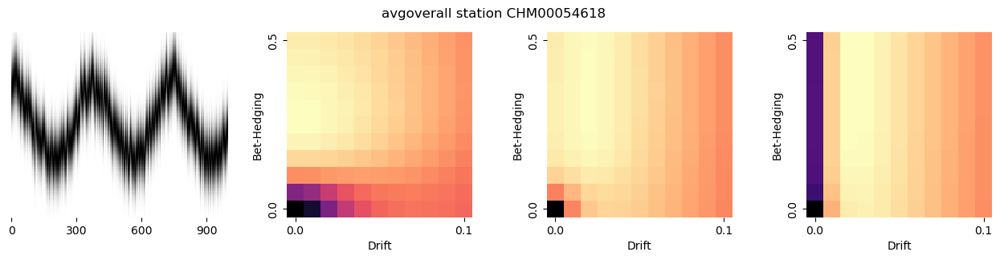

...

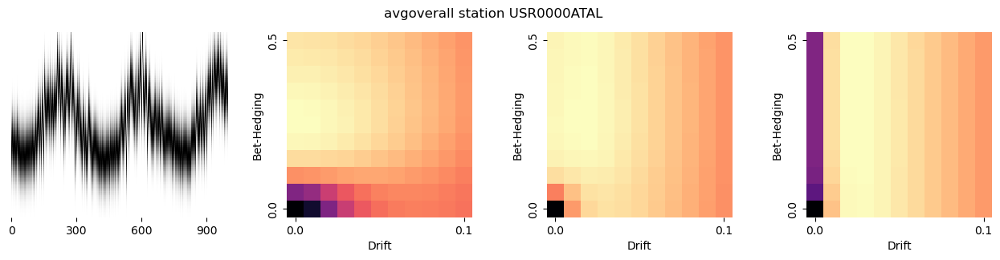

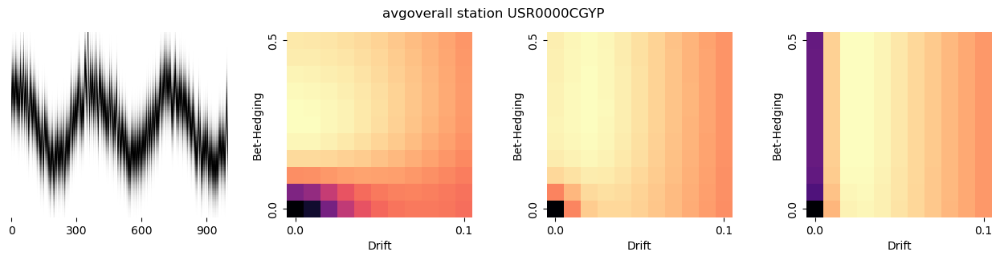

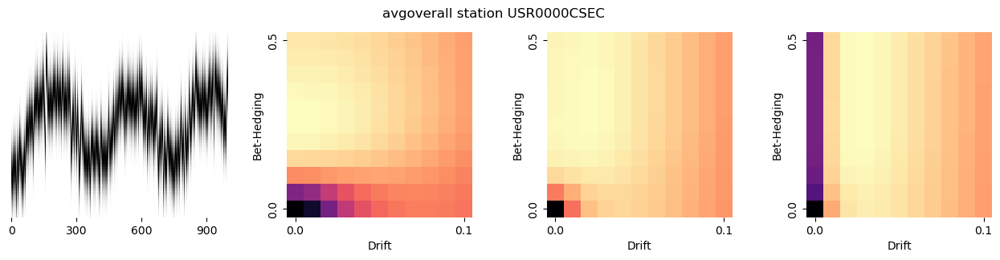

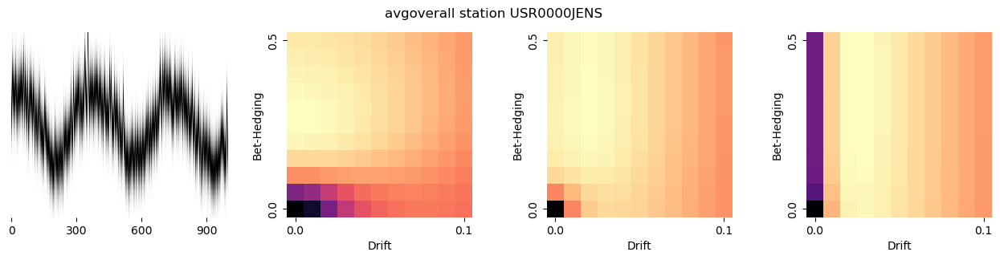

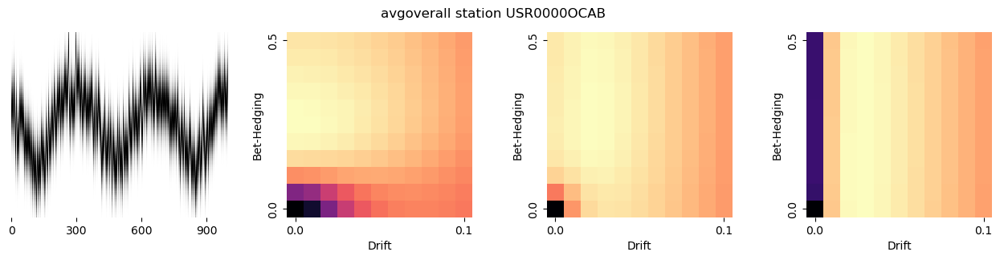

In [ ]:
i=0
for i in range(200,3000,100):
  selected=[i]
  fx=pickrealworldenvironment(c, selected, envmeanvar=.3)
  # fx.show()

PARMaximum ARIK
PARMaximum COMO
PARMaximum GUIL
PARMaximum HOPB
PARMaximum LECO
PARMaximum LEWI
PARMaximum MART
PARMaximum MAYF
PARMaximum MCDI
PARMaximum POSE
PARMaximum PRIN
PARMaximum WALK
PARMaximum MAYF
PARMean ARIK
PARMean COMO
PARMean GUIL
PARMean HOPB
PARMean LECO
PARMean LEWI
PARMean MART
PARMean MAYF


/var/folders/s_/7_g1r1fs2wdcxn113q39_gzw0000gn/T/ipykernel_78510/1389424764.py:5: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  f,axs=plt.subplots(1,4, figsize=(16,3))


PARMean MCDI
PARMean POSE
PARMean PRIN
PARMean WALK
PARMean MAYF
PARStdErMean ARIK
PARStdErMean COMO
PARStdErMean GUIL
PARStdErMean HOPB
PARStdErMean LECO
PARStdErMean LEWI
PARStdErMean MART
PARStdErMean MAYF
PARStdErMean MCDI
PARStdErMean POSE
PARStdErMean PRIN
PARStdErMean WALK
PARStdErMean MAYF
PARVariance ARIK
PARVariance COMO
PARVariance GUIL
PARVariance HOPB
PARVariance LECO
PARVariance LEWI
PARVariance MART
PARVariance MAYF
PARVariance MCDI
PARVariance POSE
PARVariance PRIN
PARVariance WALK
PARVariance MAYF
RHMaximum ABBY
RHMaximum ARIK
RHMaximum BARC
RHMaximum BARR
RHMaximum BART
RHMaximum BLAN
RHMaximum BONA
RHMaximum CARI
RHMaximum CLBJ
RHMaximum COMO
RHMaximum CPER
RHMaximum CRAM
RHMaximum DCFS
RHMaximum DEJU
RHMaximum DSNY
RHMaximum GRSM
RHMaximum HARV
RHMaximum HEAL
RHMaximum HOPB
RHMaximum JERC
RHMaximum JORN
RHMaximum KING
RHMaximum KONZ
RHMaximum LECO
RHMaximum LIRO
RHMaximum MAYF
RHMaximum MOAB
RHMaximum NIWO
RHMaximum NOGP
RHMaximum OAES
RHMaximum ONAQ
RHMaximum ORNL


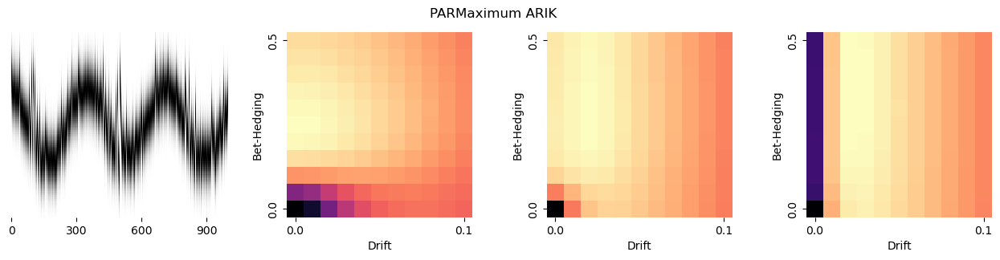

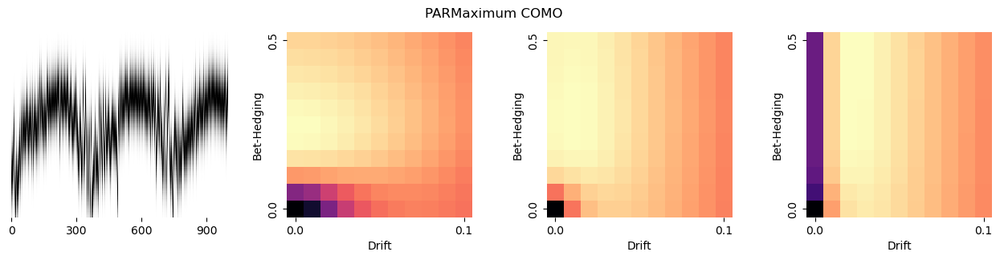

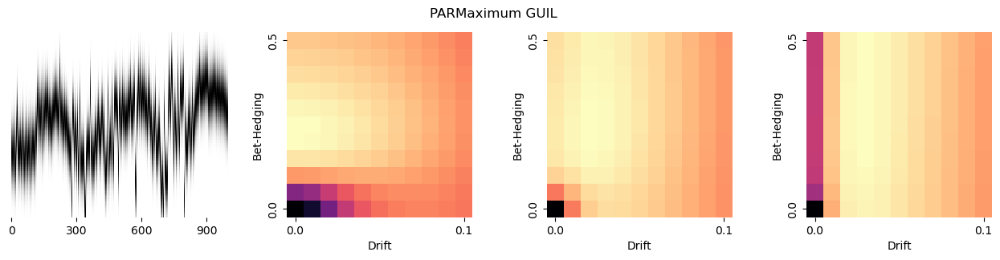

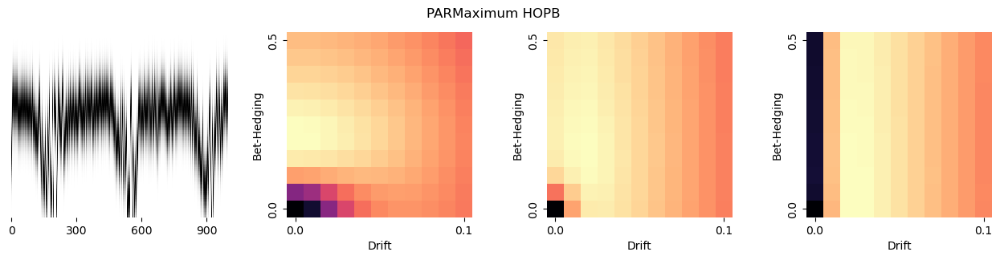

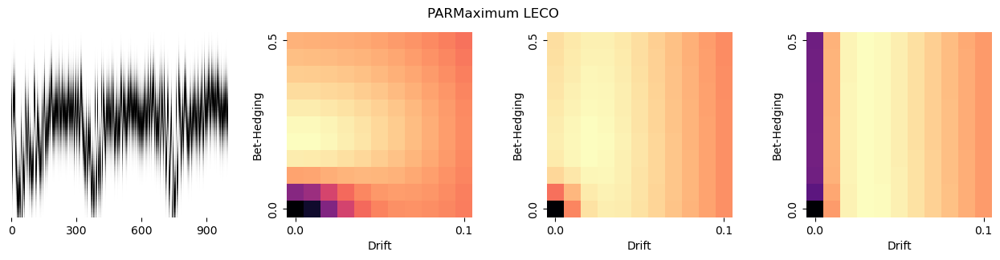

...

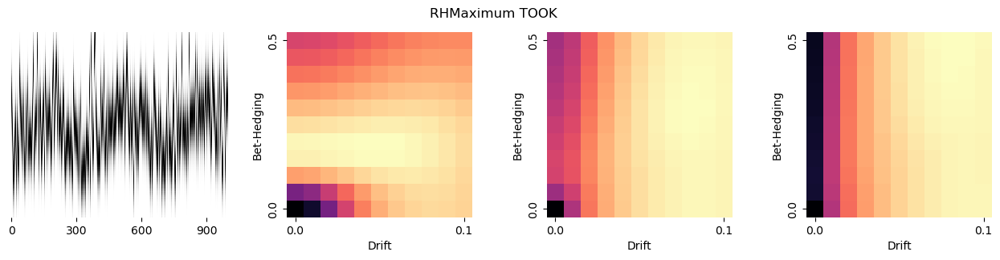

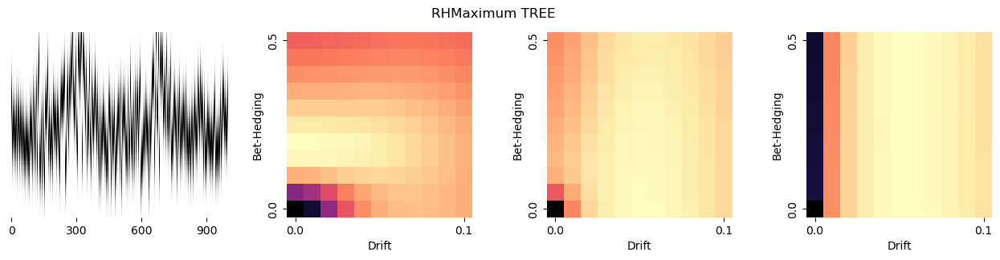

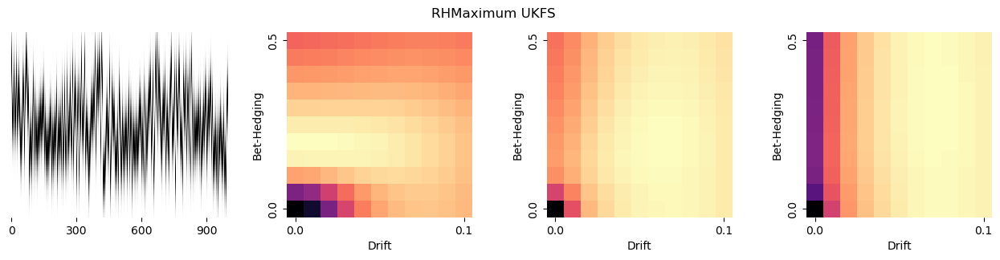

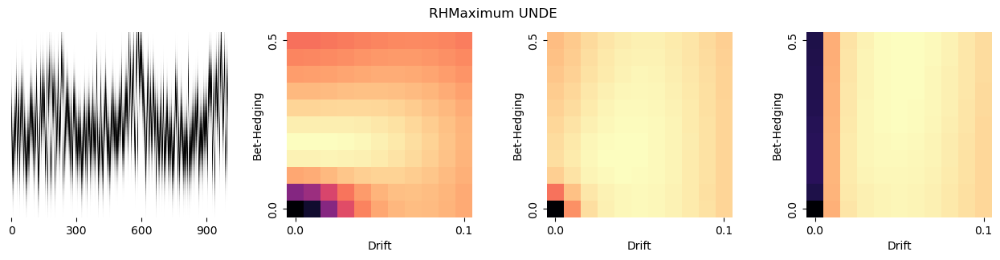

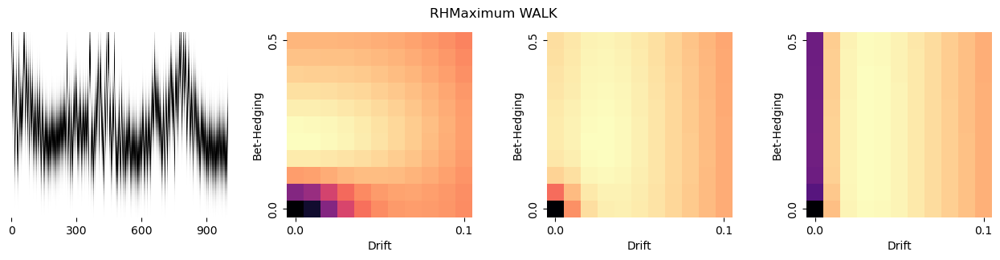

In [ ]:
i=0
for i in range(0,100):
  selected=[i]
  fx=pickrealworldenvironment(c, selected, envmeanvar=.3)
  # fx.show()

In [ ]:
px.imshow(np.log10(c["df"]).sel(envmeanvar=.1).mean(dim="simkey"), facet_col="matureage")
a

In [ ]:
px.imshow(np.log10(c["df"]).sel(envmeanvar=.1).mean(dim="simkey"), facet_col="matureage")


In [ ]:
px.imshow(np.log10(c["df"]).sel(envmeanvar=.1).mean(dim="simkey"), facet_col="matureage", range_color=[-40,40])


In [ ]:
# def draw_heatmap(*args, **kwargs):
#     data = kwargs.pop('data')
#     d = data.pivot(index=args[1], columns=args[0], values=args[2]).squeeze()
#     sns.heatmap(d, **kwargs)

fg=np.log10(ccr["df"]).mean(dim="simkey")
fgd=fg.to_dataframe()


In [ ]:
fgdd=fgd.reset_index()

In [ ]:
fgdd

,matureage,envmeanvar,bet-hedging,drift,birthrate,envvar,df
0,10,0.1,0.0,0.00,40,0.3,90.883797
1,10,0.1,0.0,0.01,40,0.3,90.363068
2,10,0.1,0.0,0.02,40,0.3,88.272887
3,10,0.1,0.0,0.03,40,0.3,85.070287
4,10,0.1,0.0,0.04,40,0.3,81.172372
...,...,...,...,...,...,...,...
1084,360,0.3,0.5,0.06,40,0.3,-123.248031
1085,360,0.3,0.5,0.07,40,0.3,-126.304428
1086,360,0.3,0.5,0.08,40,0.3,-129.473966
1087,360,0.3,0.5,0.09,40,0.3,-132.708170


/Users/ryanmaloney/miniforge3/lib/python3.9/site-packages/pandas/core/common.py:241: VisibleDeprecationWarning:

Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.



TypeError: unhashable type: 'DataFrame'

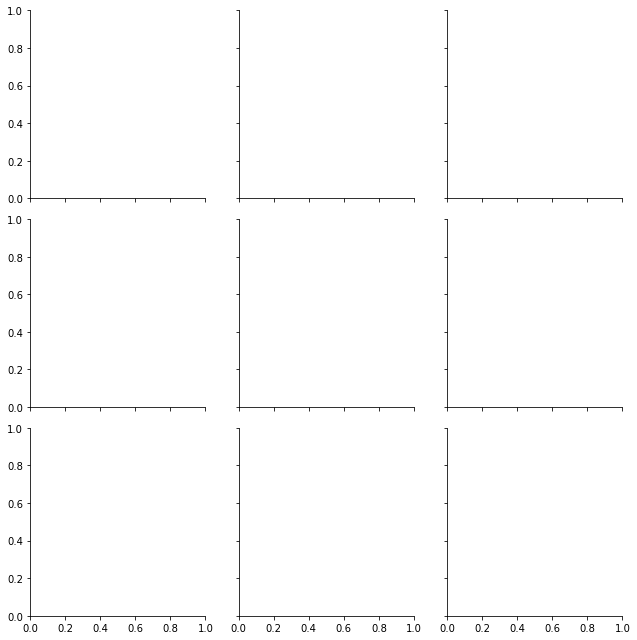

In [ ]:
g=sns.FacetGrid(fgdd, col="matureage", row="envmeanvar")
g.map(sns.heatmap, fgdd, "drift", "bet-hedging")

In [ ]:

px.imshow(ccr["maxbhi"].mean(dim="simkey"))

In [ ]:
# ccr.to_netcdf("allsimresults.nc")

In [ ]:
nottrouble="/Users/ryanmaloney/Documents/GitHub/Simplified-Drift-Modeling/Results/realworlddata/figs_6-6-22/figs/wsf2overall_station USW00003991_c0.nc"
trouble="/Users/ryanmaloney/Documents/GitHub/Simplified-Drift-Modeling/Results/realworlddata/figs_6-6-22/figs/snwdoverall_station USW00013880_c1.nc"

ta=xr.load_dataset(trouble)
nta=xr.load_dataset(nottrouble)

In [ ]:
nta

<xarray.Dataset>
Dimensions:      (day: 1000, bet-hedging: 11, drift: 11, matureage: 3, envmeanvar: 3)
Coordinates:
  * day          (day) int32 0 1 2 3 4 5 6 7 ... 992 993 994 995 996 997 998 999
    siteID       object 'station USW00003991'
  * bet-hedging  (bet-hedging) float64 0.0 0.05 0.1 0.15 ... 0.35 0.4 0.45 0.5
  * drift        (drift) float64 0.0 0.01 0.02 0.03 0.04 ... 0.07 0.08 0.09 0.1
    variable     object 'wsf2overall'
  * matureage    (matureage) int32 10 60 360
  * envmeanvar   (envmeanvar) float64 0.1 0.2 0.3
    birthrate    int32 40
    envvar       float64 0.3
    chunk        int32 0
Data variables:
    envi         (day) float64 -0.4837 0.2156 2.119 ... -0.6391 0.02137 -0.3283
    df           (matureage, envmeanvar, bet-hedging, drift) float64 1.921e+9...

In [ ]:
ta

<xarray.Dataset>
Dimensions:      (day: 1000, bet-hedging: 11, drift: 11, matureage: 3, envmeanvar: 3)
Coordinates:
  * day          (day) int32 0 1 2 3 4 5 6 7 ... 992 993 994 995 996 997 998 999
    siteID       object 'station USW00013880'
  * bet-hedging  (bet-hedging) float64 0.0 0.05 0.1 0.15 ... 0.35 0.4 0.45 0.5
  * drift        (drift) float64 0.0 0.01 0.02 0.03 0.04 ... 0.07 0.08 0.09 0.1
    variable     object 'snwdoverall'
  * matureage    (matureage) int32 10 60 360
  * envmeanvar   (envmeanvar) float64 0.1 0.2 0.3
    birthrate    int32 40
    envvar       float64 0.3
    chunk        int32 1
Data variables:
    envi         (day) float64 nan nan nan nan nan nan ... nan nan nan nan nan
    df           (matureage, envmeanvar, bet-hedging, drift) float64 nan ... nan

In [ ]:

pd.read_csv("../Scripts/AllChunks.csv", nrows=10)

,Unnamed: 0,Unnamed: 1,Unnamed: 2,value,value.1,value.2,value.3,value.4,value.5,value.6,...,value.990,value.991,value.992,value.993,value.994,value.995,value.996,value.997,value.998,value.999
0,day,NaN,NaN,0.000000,1.000000,2.000000,3.000000,4.000000,5.000000,6.000000,...,990.000000,991.000000,992.000000,993.000000,994.000000,995.000000,996.000000,997.000000,998.000000,999.000000
1,variable,chunk,siteID,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,PARVariance,0,ARIK,-0.767824,-0.647013,-0.707687,-0.728347,-0.623532,-0.755852,-0.621942,...,-0.521076,-0.638355,0.236562,-0.670939,-0.593484,-0.642956,-0.597368,-0.685161,-0.379228,0.184788
3,PARVariance,0,COMO,0.783312,-0.028794,1.509013,1.458887,1.957903,2.517762,1.384542,...,-0.604481,-0.542063,-0.452901,-0.665505,-0.512444,-0.388403,-0.663679,-0.666216,-0.663363,-0.664464
4,PARVariance,0,GUIL,1.574709,1.987556,1.443178,1.220907,-0.264031,-0.523910,0.821843,...,-0.602758,-0.627846,-0.287783,-0.938772,-0.760713,-0.648846,-0.540877,-0.989598,-0.684984,-0.473078
5,PARVariance,0,HOPB,0.120826,-0.342595,-0.576241,-0.561249,-0.546183,-0.519506,-0.487838,...,-0.574988,-0.580597,-0.580660,-0.404985,-0.353393,-0.360716,-0.378120,-0.580560,-0.576806,-0.561162
6,PARVariance,0,LECO,-0.856963,-0.849032,-0.884006,1.337081,0.790954,-0.091954,-0.401244,...,-0.651807,-0.858255,-0.697196,-0.881591,-0.540457,-0.547911,-0.543870,-0.568510,-0.609101,-0.825736
7,PARVariance,0,LEWI,-0.705585,-0.664558,0.277751,0.272019,0.582334,-0.478079,-0.553962,...,0.086554,0.203172,-0.431754,-0.052776,0.080504,-0.349726,-0.179100,-0.463995,-0.710044,-0.718871
8,PARVariance,0,MART,4.873269,2.703849,2.296087,2.454160,1.345806,2.779923,2.317138,...,-0.681169,0.119840,-0.762978,-0.784674,-0.795104,-0.756033,-0.789568,-0.451433,0.417125,0.408852
9,PARVariance,0,MAYF,-0.533584,-0.717335,-0.752526,0.899289,2.234226,2.054288,-0.457368,...,-0.724054,-0.130386,-0.074670,-0.223952,-0.752692,-0.759522,-0.752722,-0.114106,0.084212,0.093126


In [ ]:

xr.merge([max_drift_i, z], concat_dim=["matureage", "envmeanvar", None])

ValueError: concat_dims has length 3 but the datasets passed are nested in a 1-dimensional structure

In [ ]:
np.expand_dims(np.array(singlerun.where(ss==max1, drop=True)['drift']), axis=1)

array([], shape=(0, 1), dtype=float64)

In [ ]:
ax.v

()

In [ ]:
b.merge({"maxdrifti":max_drift_i})

ValueError: arguments without labels along dimension 'matureage' cannot be aligned because they have different dimension size(s) {1} than the size of the aligned dimension labels: 3

In [ ]:
max_drift_i.to_dataset()

<xarray.Dataset>
Dimensions:     (drift: 1)
Coordinates:
    envmeanvar  float64 0.3
    matureage   int32 360
Dimensions without coordinates: drift
Data variables:
    drift       (drift) float64 0.03

In [ ]:
singlerun

<xarray.Dataset>
Dimensions:      (day: 1000, bet-hedging: 11, drift: 11)
Coordinates:
  * day          (day) int32 0 1 2 3 4 5 6 7 ... 992 993 994 995 996 997 998 999
  * bet-hedging  (bet-hedging) float64 0.0 0.05 0.1 0.15 ... 0.35 0.4 0.45 0.5
  * drift        (drift) float64 0.0 0.01 0.02 0.03 0.04 ... 0.07 0.08 0.09 0.1
    variable     object 'PARVariance'
    siteID       object 'COMO'
    matureage    int32 360
    envmeanvar   float64 0.3
    birthrate    int32 40
    envvar       float64 0.3
    chunk        int32 0
Data variables:
    envi         (day) float64 0.7833 -0.02879 1.509 ... -0.6662 -0.6634 -0.6645
    df           (bet-hedging, drift) float64 8.499e-204 ... 1.529e-139
    hi           int64 1